In [1]:
import os
import cv2
import numpy as np
from glob import glob
from PIL import Image
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchsummary import summary
from torchvision import transforms
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader

In [2]:
LEARNING_RATE = 3e-4
BATCH_SIZE = 4
DATA_LENGTH = 1000
EPOCH = 100

REF_H, REF_W = 768, 1024

AIM_RES = 512

IMAGE_PATH = 'E:\\dataset\\completed\\mixed\\'
MASK_PATH = 'E:\\dataset\\completed\\mask\\'
PEOPLE_PATH = 'E:\\dataset\\completed\\people\\'
BACKGROUND_PATH = 'E:\\dataset\\completed\\background\\'
MASKED_BACKGROUND_PATH = 'E:\\dataset\\completed\\masked_background\\'

device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
class CustomDataset(Dataset):
    def __init__(self, masked_background_path, background_path, transform = None):
        self.masked_background_path = masked_background_path
        self.background_path = background_path
        self.transform = transform
    
    def __getitem__(self, idx):
        
        masked_background = Image.open(self.masked_background_path[idx]).convert('RGB')
        background = Image.open(self.background_path[idx]).convert('RGB')
        
        random_seed = np.random.randint(-99999, 99999)
        if self.transform:
            torch.manual_seed(random_seed)
            masked_background = self.transform(masked_background)
            torch.manual_seed(random_seed)
            background = self.transform(background)
            
        masked_background = (masked_background + 1) / 2
        background = (background + 1) / 2
            
        noise_image = np.random.rand(3, AIM_RES, AIM_RES)
        noise_idx = np.where(masked_background.numpy() != 0)
        noise_image[noise_idx] = np.float32(0)
        masked_background = torch.tensor(masked_background.numpy() + noise_image)        
    
        # print(f'mb: {masked_background.shape}\nbg: {background.shape}')
        
        return masked_background.type(torch.float32), background.type(torch.float32)
    
    def __len__(self):
        return len(self.masked_background_path)

In [4]:
train_masked_background = np.array(sorted(glob(MASKED_BACKGROUND_PATH + '*')))[:DATA_LENGTH]
train_background = np.array(sorted(glob(BACKGROUND_PATH + '*')))[:DATA_LENGTH]

train_masked_background[:5], train_background[:5]

(array(['E:\\dataset\\completed\\masked_background\\0_0_maskedbackground.png',
        'E:\\dataset\\completed\\masked_background\\1000_0_maskedbackground.png',
        'E:\\dataset\\completed\\masked_background\\1001_0_maskedbackground.png',
        'E:\\dataset\\completed\\masked_background\\1002_0_maskedbackground.png',
        'E:\\dataset\\completed\\masked_background\\1003_0_maskedbackground.png'],
       dtype='<U66'),
 array(['E:\\dataset\\completed\\background\\0_0_background.png',
        'E:\\dataset\\completed\\background\\1000_0_background.png',
        'E:\\dataset\\completed\\background\\1001_0_background.png',
        'E:\\dataset\\completed\\background\\1002_0_background.png',
        'E:\\dataset\\completed\\background\\1003_0_background.png'],
       dtype='<U53'))

In [5]:
masked_background_train, masked_background_test, background_train, background_test = train_test_split(train_masked_background, train_background, test_size = 0.2, random_state = 7, shuffle = True)
masked_background_train.shape, background_train.shape, masked_background_test.shape, background_test.shape

((800,), (800,), (200,), (200,))

In [6]:
masked_background_train, masked_background_valid, background_train, background_valid = train_test_split(masked_background_train, background_train, test_size = 0.3, random_state = 77, shuffle = True)
masked_background_train.shape, background_train.shape, masked_background_valid.shape, background_valid.shape

((560,), (560,), (240,), (240,))

In [7]:
transform = transforms.Compose([
    transforms.Resize([AIM_RES, AIM_RES]),
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [8]:
train_dataset = CustomDataset(masked_background_train, background_train, transform)
valid_dataset = CustomDataset(masked_background_test, background_test, transform)

In [9]:
train_loader = DataLoader(dataset = train_dataset, batch_size = BATCH_SIZE, shuffle = True, num_workers = 0)
valid_loader = DataLoader(dataset = valid_dataset, batch_size = BATCH_SIZE, shuffle = True, num_workers = 0)

out! image: torch.Size([4, 3, 512, 512]), mask: torch.Size([4, 3, 512, 512])


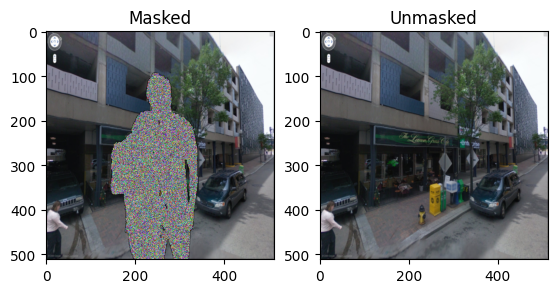

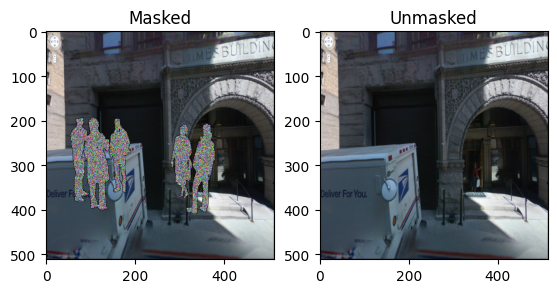

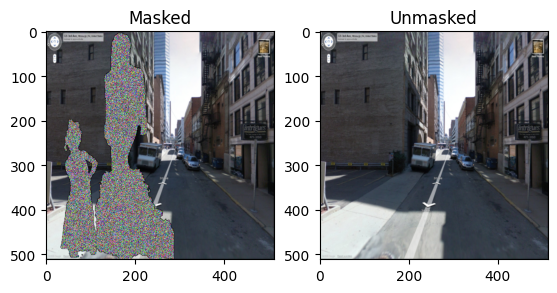

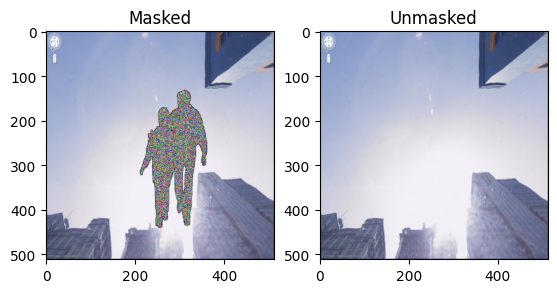

In [10]:
image, mask = next(iter(train_loader))

print(f'out! image: {image.shape}, mask: {mask.shape}')

image = image.permute(0, 2, 3, 1)
mask = mask.permute(0, 2, 3, 1)

# image = image.reshape(-1, AIM_RES, AIM_RES, 3)
# mask = mask.reshape(-1, AIM_RES, AIM_RES, 3)

for i in range(BATCH_SIZE):
    plt.figure(figsize = (10, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(image[i])
    plt.title('Masked')
    plt.subplot(1, 3, 2)
    plt.imshow(mask[i])
    plt.title('Unmasked')
    plt.show()

In [12]:
class ResBlock(nn.Module):
    def __init__(self, in_feature, out_feature):
        super(ResBlock, self).__init__()
    
        self.model = nn.Sequential(
            nn.Conv2d(in_feature, out_feature, kernel_size=3, padding=1, padding_mode='reflect'),
            nn.BatchNorm2d(out_feature),
            nn.ReLU(),
        )
    
    def forward(self, x):
        return x + self.model(x)

In [14]:
def conv_block(in_dim, out_dim, kernel_size, stride, padding):
    model = nn.Sequential(
        nn.Conv2d(in_dim, out_dim, kernel_size, stride = stride, padding = padding, padding_mode = 'reflect'),
        nn.BatchNorm2d(out_dim),
        nn.ReLU()
    )
    return model

def conv_transpose_block(in_dim, out_dim):
    model = nn.Sequential(
        nn.ConvTranspose2d(in_dim, out_dim, kernel_size = 3, stride = 2, padding = 1, output_padding = 1),
        nn.BatchNorm2d(out_dim),
        nn.ReLU()
    )
    return model

In [15]:
class MaintainAutoEncoder(nn.Module):
    def __init__(self):
        super(MaintainAutoEncoder, self).__init__()
        
        self.model = nn.Sequential(
            conv_block(3, 64, 3, 1, 1),
            nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0),
            conv_block(64, 128, 3, 1, 1),
            nn.MaxPool2d(kernel_size = 2, stride = 2, padding = 0),
            conv_block(128, 256, 3, 1, 1),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            ResBlock(256, 256),
            conv_transpose_block(256, 128),
            conv_transpose_block(128, 64),
            conv_block(64, 3, 3, 1, 1)
            # nn.Tanh()
        )
    
    def forward(self, x):
        return self.model(x)

In [16]:
model = MaintainAutoEncoder().to(device)
summary(model, (3, AIM_RES, AIM_RES), batch_size = BATCH_SIZE)
optimizer = torch.optim.Adam(model.parameters(), lr = LEARNING_RATE)
criterion = nn.MSELoss().to(device)

model.load_state_dict(torch.load('./models/FCAE/prev_best_model.pth'))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [4, 64, 512, 512]           1,792
       BatchNorm2d-2          [4, 64, 512, 512]             128
              ReLU-3          [4, 64, 512, 512]               0
         MaxPool2d-4          [4, 64, 256, 256]               0
            Conv2d-5         [4, 128, 256, 256]          73,856
       BatchNorm2d-6         [4, 128, 256, 256]             256
              ReLU-7         [4, 128, 256, 256]               0
         MaxPool2d-8         [4, 128, 128, 128]               0
            Conv2d-9         [4, 256, 128, 128]         295,168
      BatchNorm2d-10         [4, 256, 128, 128]             512
             ReLU-11         [4, 256, 128, 128]               0
           Conv2d-12         [4, 256, 128, 128]         590,080
      BatchNorm2d-13         [4, 256, 128, 128]             512
             ReLU-14         [4, 256, 1

<All keys matched successfully>

Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! inf -> 0.00787541616242379


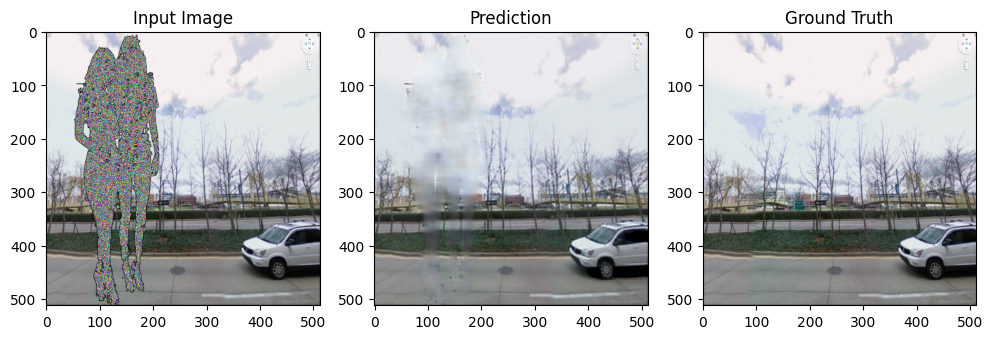

Epoch 0
=--------------------------------=
Train Loss: 0.008255249393239085, Validation Loss: 0.00787541616242379
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.00787541616242379 -> 0.007090804302133619


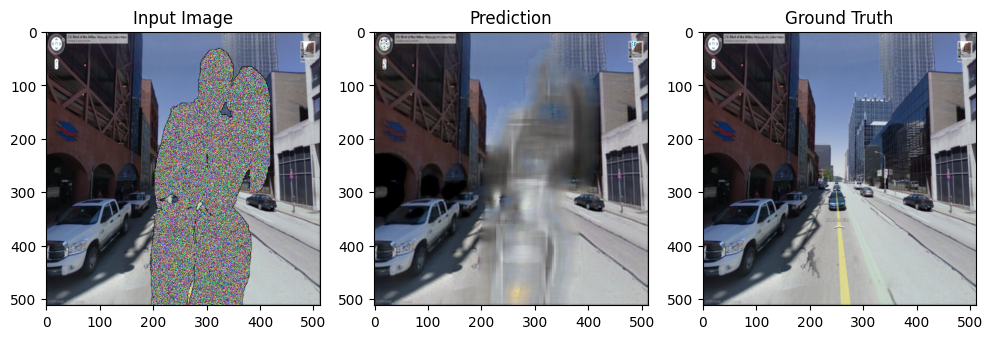

Epoch 1
=--------------------------------=
Train Loss: 0.008225465951753514, Validation Loss: 0.007090804302133619
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

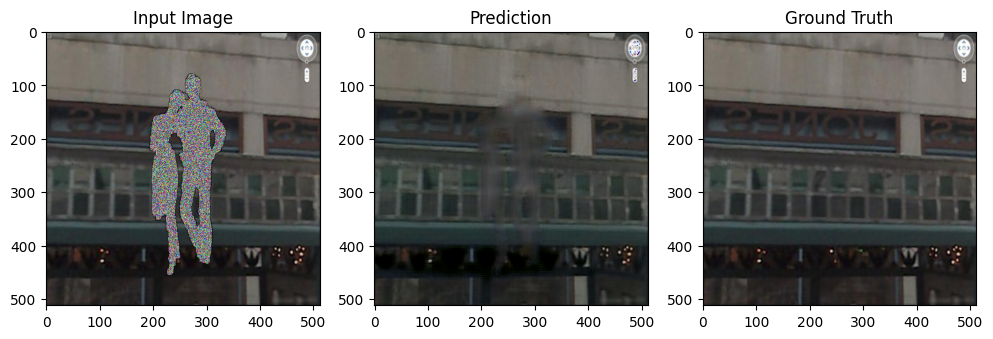

Epoch 2
=--------------------------------=
Train Loss: 0.008136812264897994, Validation Loss: 0.007306521744467318
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.007090804302133619 -> 0.007038473323918879


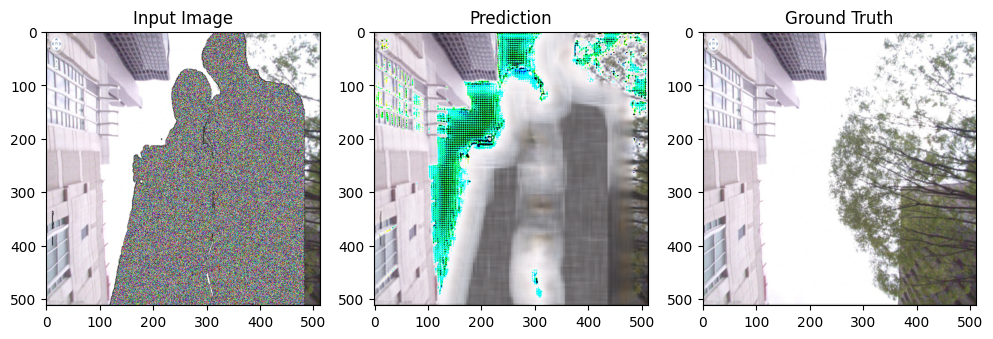

Epoch 3
=--------------------------------=
Train Loss: 0.008612170701547127, Validation Loss: 0.007038473323918879
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

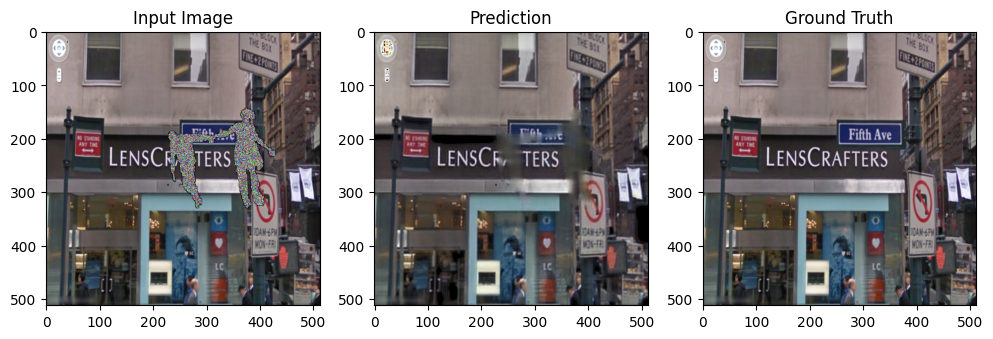

Epoch 4
=--------------------------------=
Train Loss: 0.008195335037141507, Validation Loss: 0.007583659482188523
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

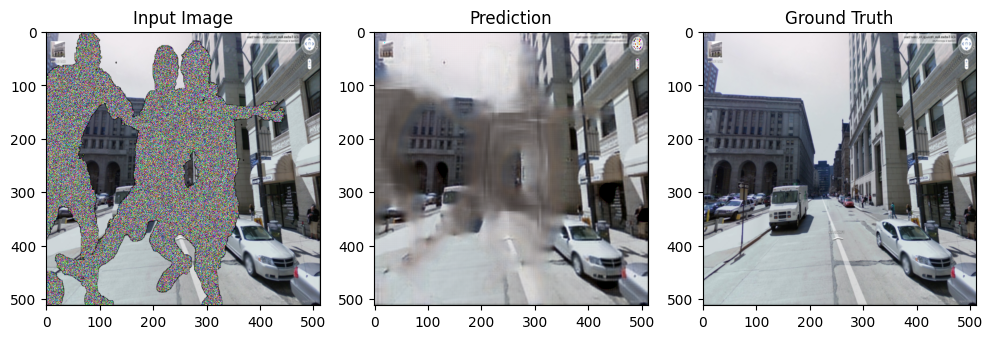

Epoch 5
=--------------------------------=
Train Loss: 0.008108602344457592, Validation Loss: 0.007181565882638097
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

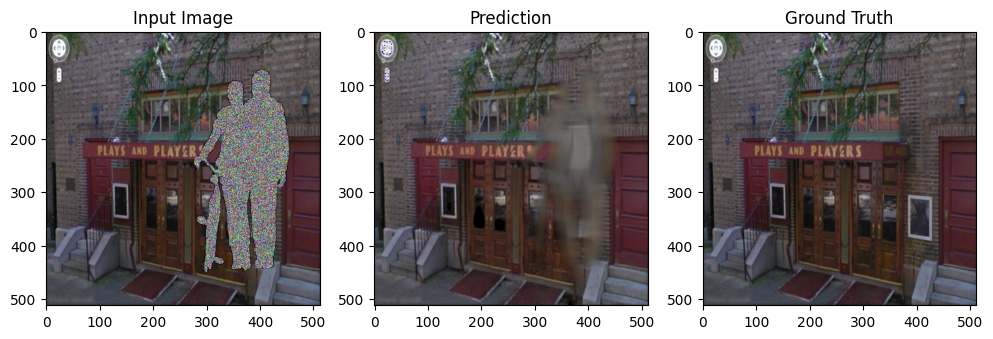

Epoch 6
=--------------------------------=
Train Loss: 0.007864819111169449, Validation Loss: 0.007143357456661761
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

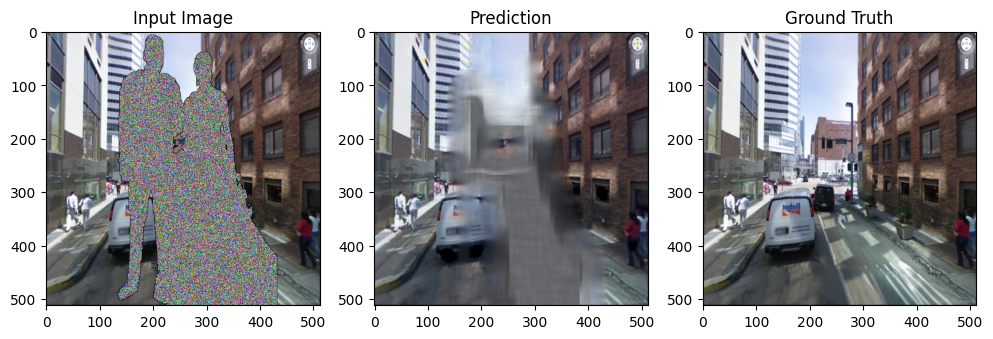

Epoch 7
=--------------------------------=
Train Loss: 0.007592697150539607, Validation Loss: 0.007131860214285552
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

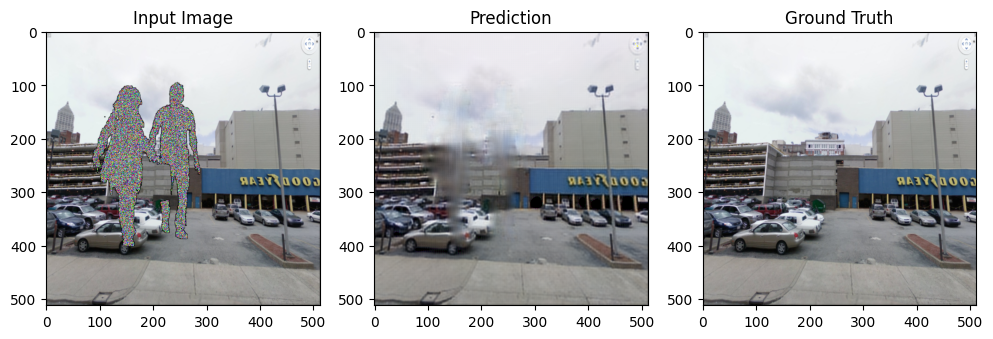

Epoch 8
=--------------------------------=
Train Loss: 0.007719937861630959, Validation Loss: 0.007549936077557504
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

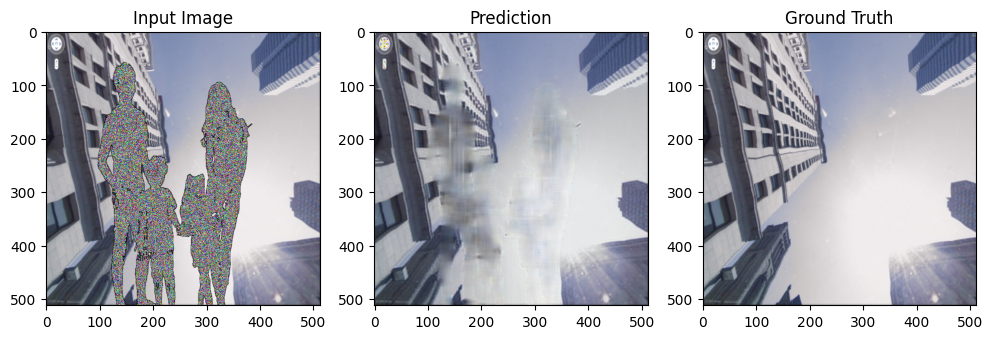

Epoch 9
=--------------------------------=
Train Loss: 0.007673599600093439, Validation Loss: 0.007305371849797666
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

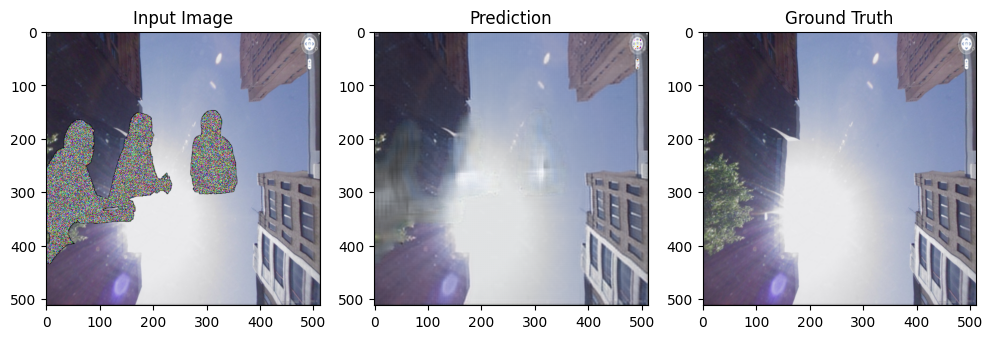

Epoch 10
=--------------------------------=
Train Loss: 0.007937075462125773, Validation Loss: 0.007763975108973682
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

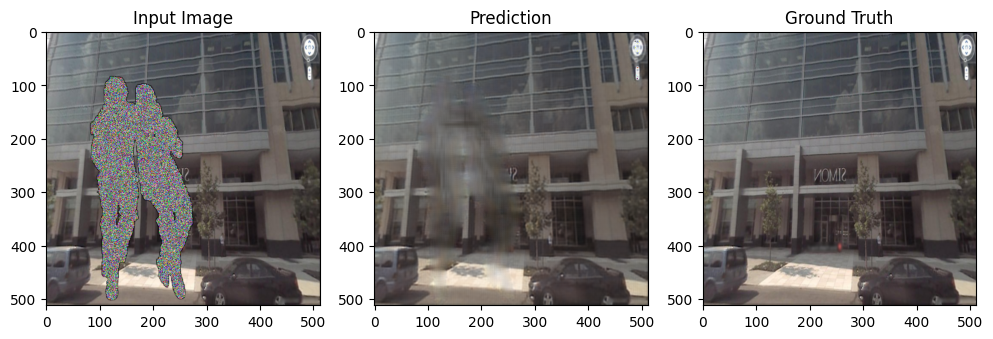

Epoch 11
=--------------------------------=
Train Loss: 0.0076441275005761, Validation Loss: 0.007630638857372105
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

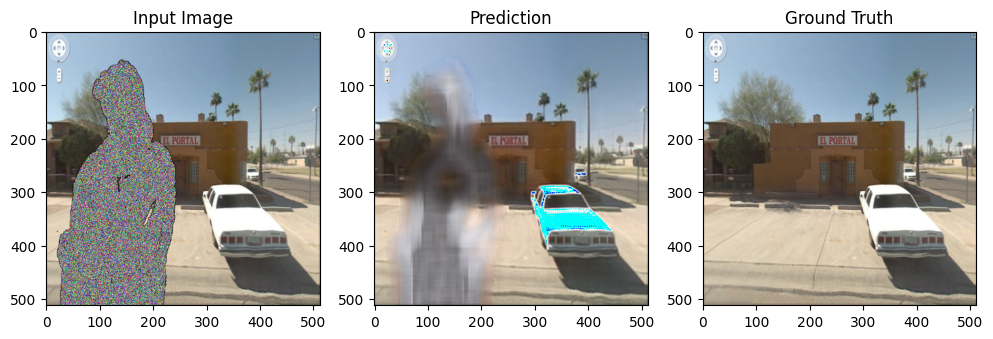

Epoch 12
=--------------------------------=
Train Loss: 0.008374235211938088, Validation Loss: 0.007446823425125331
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

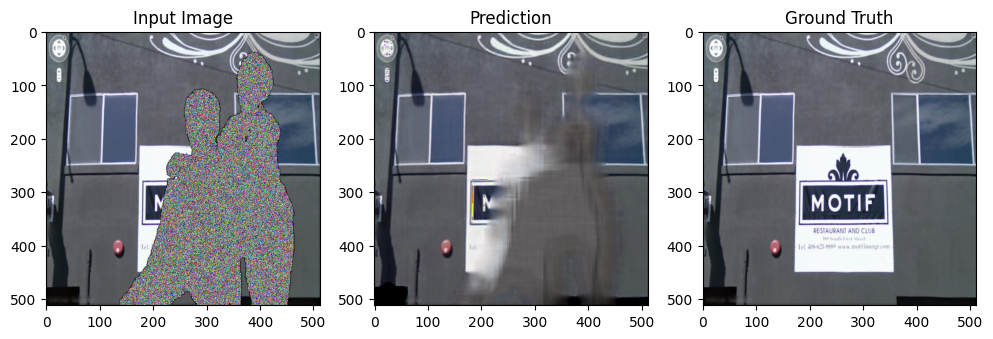

Epoch 13
=--------------------------------=
Train Loss: 0.008073093767909866, Validation Loss: 0.008075850242748856
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

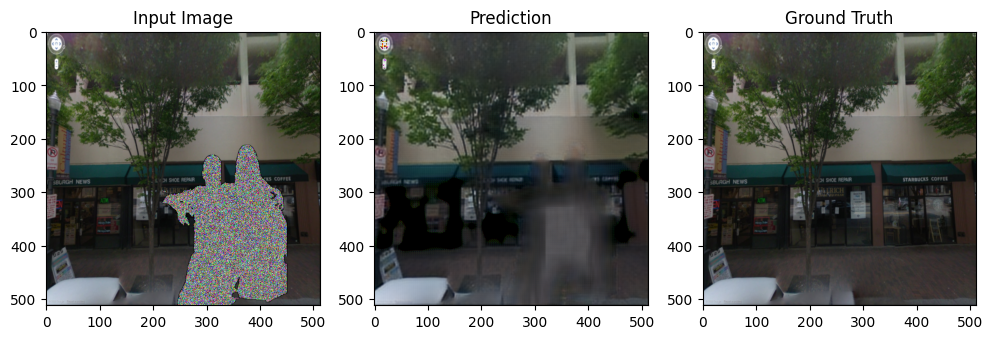

Epoch 14
=--------------------------------=
Train Loss: 0.008198769746481307, Validation Loss: 0.0088731977250427
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.007038473323918879 -> 0.007010911214165389


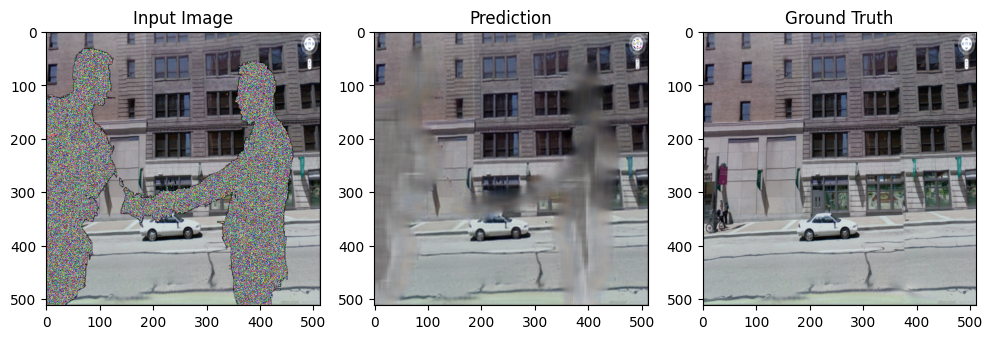

Epoch 15
=--------------------------------=
Train Loss: 0.007832555118615607, Validation Loss: 0.007010911214165389
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

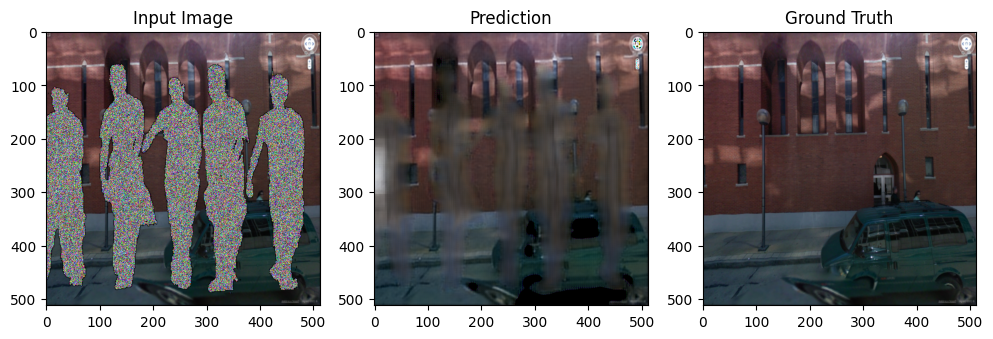

Epoch 16
=--------------------------------=
Train Loss: 0.007657918941030013, Validation Loss: 0.007098714071325958
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

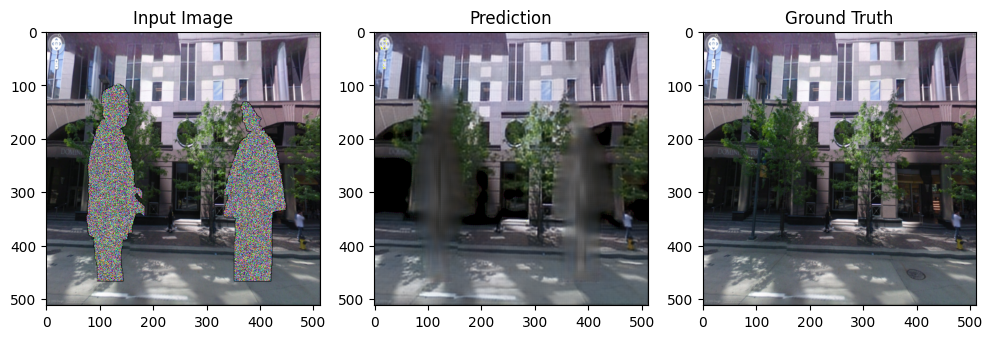

Epoch 17
=--------------------------------=
Train Loss: 0.007662939839065075, Validation Loss: 0.007524752877652645
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

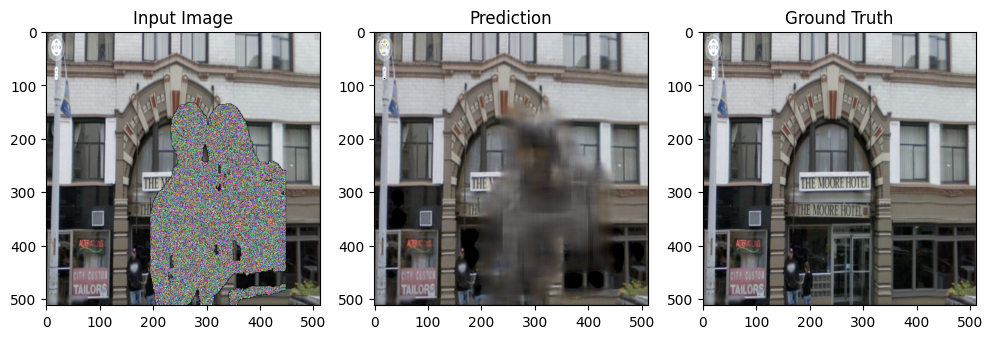

Epoch 18
=--------------------------------=
Train Loss: 0.007350398009709482, Validation Loss: 0.007592873522080481
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

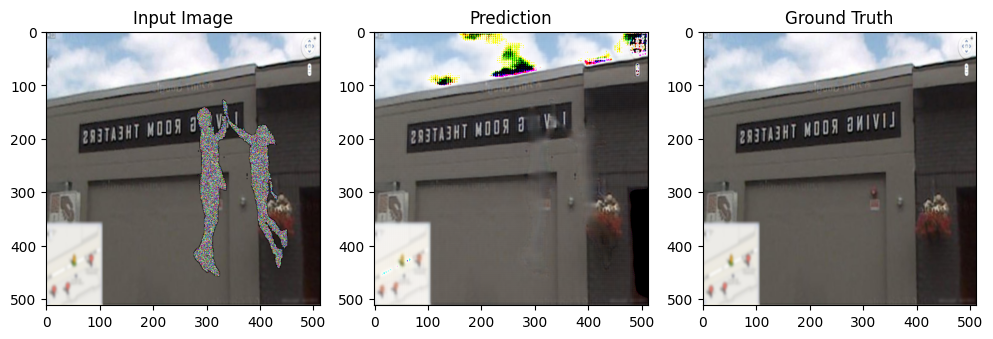

Epoch 19
=--------------------------------=
Train Loss: 0.00751868338224345, Validation Loss: 0.007880108053795994
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

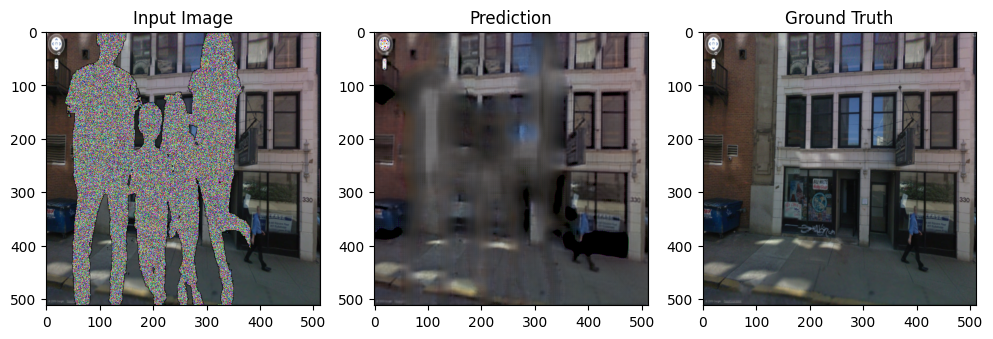

Epoch 20
=--------------------------------=
Train Loss: 0.007873987737444363, Validation Loss: 0.007125073913484812
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.007010911214165389 -> 0.006739631243981421


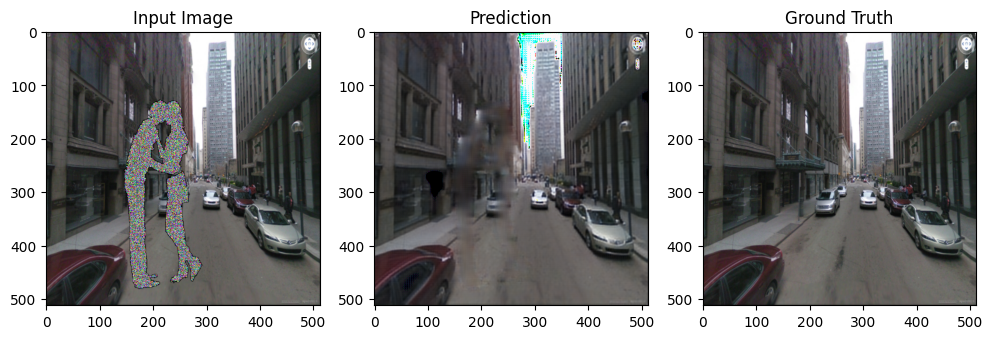

Epoch 21
=--------------------------------=
Train Loss: 0.007963744808720159, Validation Loss: 0.006739631243981421
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

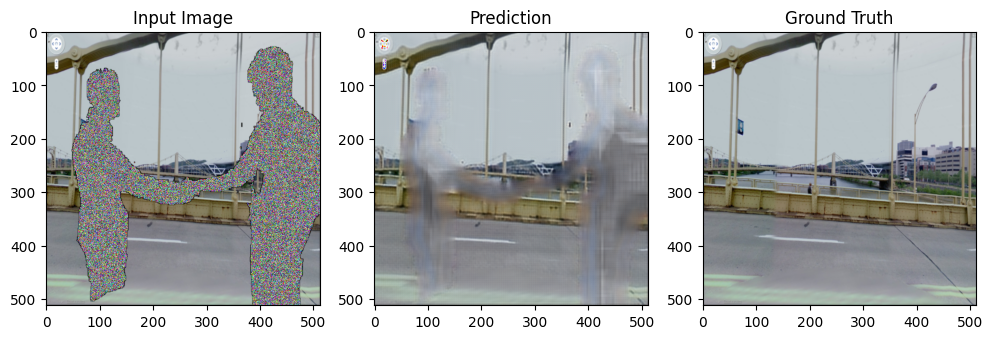

Epoch 22
=--------------------------------=
Train Loss: 0.007745730512708958, Validation Loss: 0.0076324919518083335
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

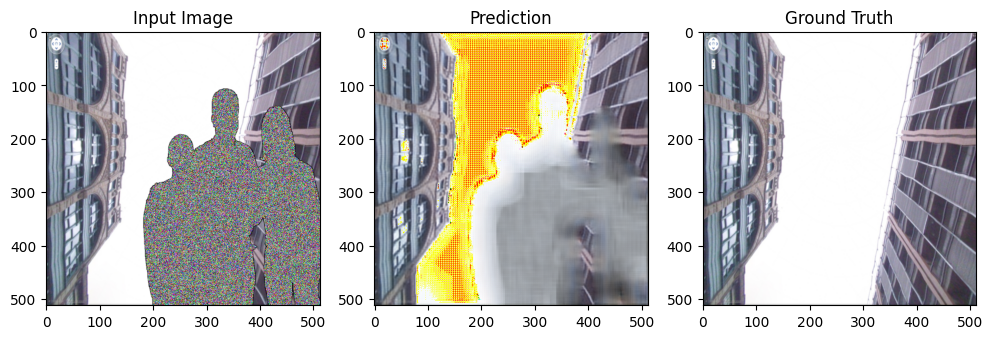

Epoch 23
=--------------------------------=
Train Loss: 0.007704896890624826, Validation Loss: 0.009034667555242777
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

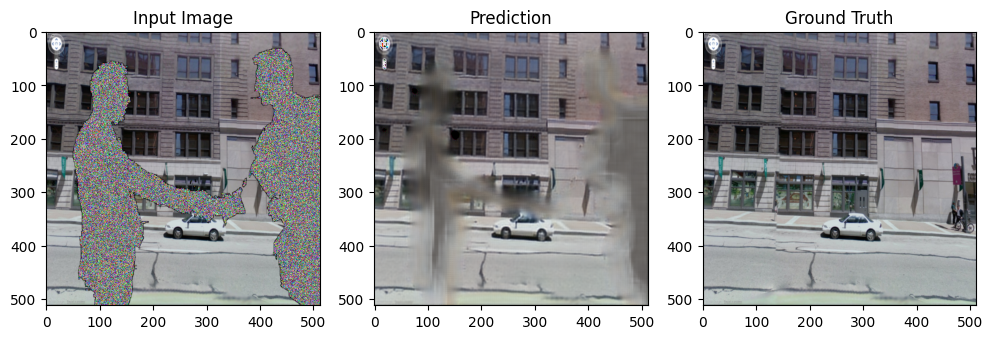

Epoch 24
=--------------------------------=
Train Loss: 0.00767054647772706, Validation Loss: 0.007279924859758467
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

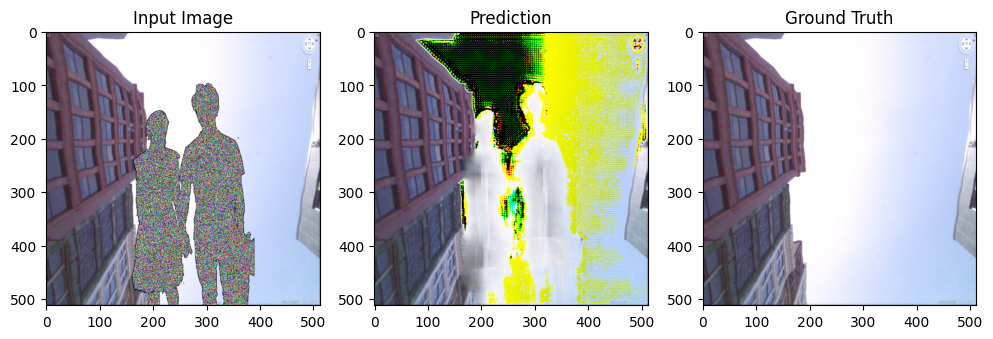

Epoch 25
=--------------------------------=
Train Loss: 0.007424610400838512, Validation Loss: 0.007125599957071245
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

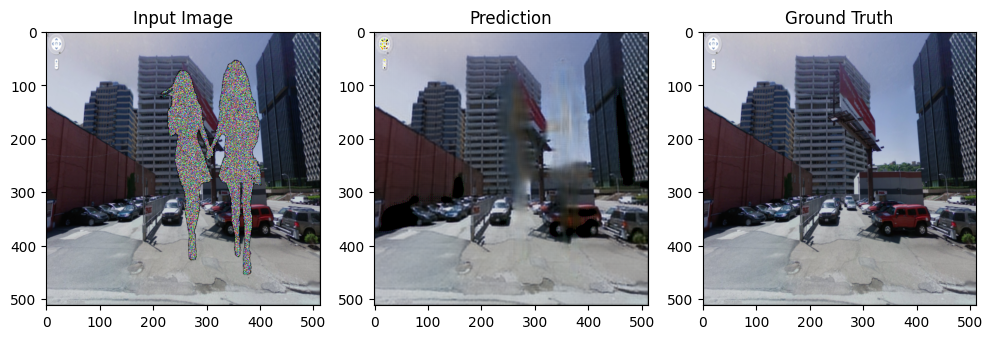

Epoch 26
=--------------------------------=
Train Loss: 0.007377831140599612, Validation Loss: 0.006776932743377984
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

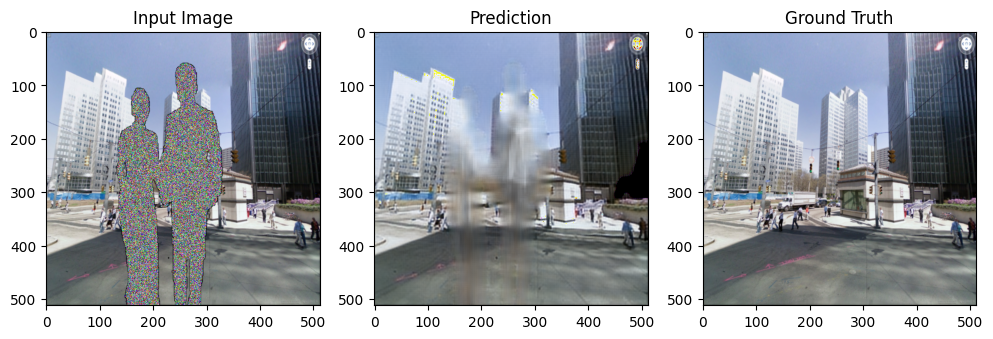

Epoch 27
=--------------------------------=
Train Loss: 0.007567214012877749, Validation Loss: 0.006961017856374383
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

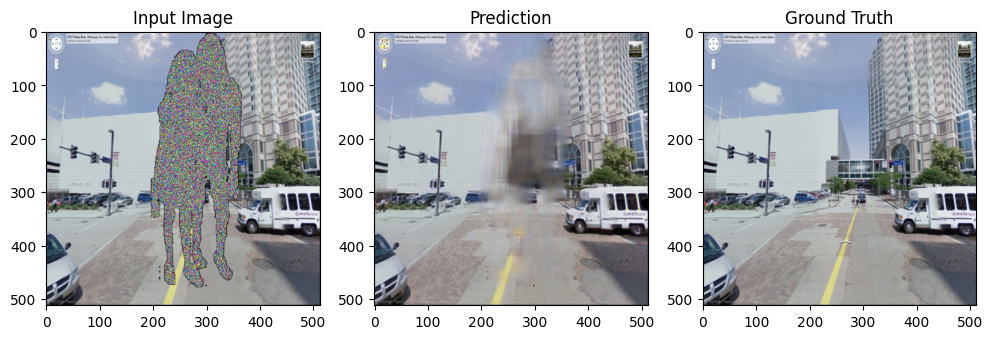

Epoch 28
=--------------------------------=
Train Loss: 0.0072389029182626735, Validation Loss: 0.007184278778731823
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

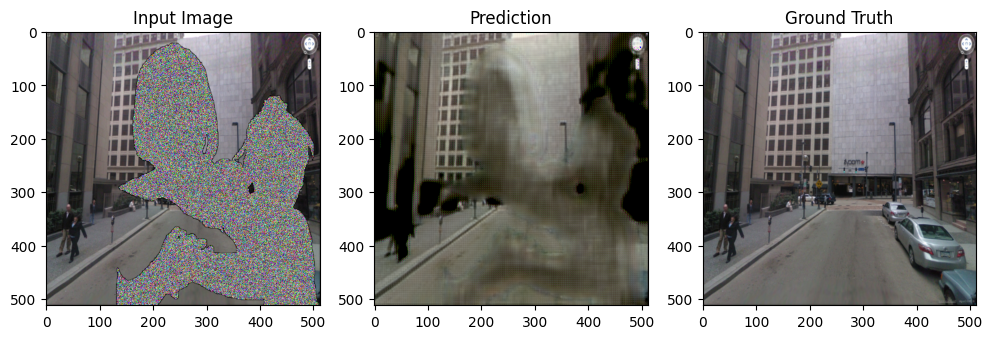

Epoch 29
=--------------------------------=
Train Loss: 0.007498948142996856, Validation Loss: 0.01547487461939454
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

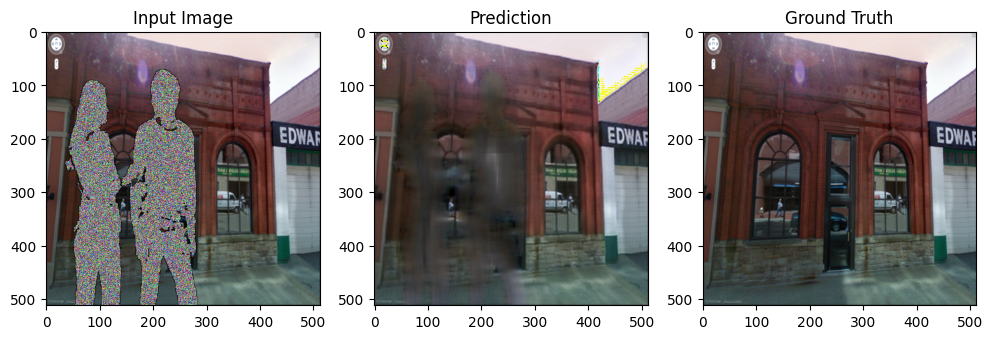

Epoch 30
=--------------------------------=
Train Loss: 0.009190355006804957, Validation Loss: 0.007070082277059555
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

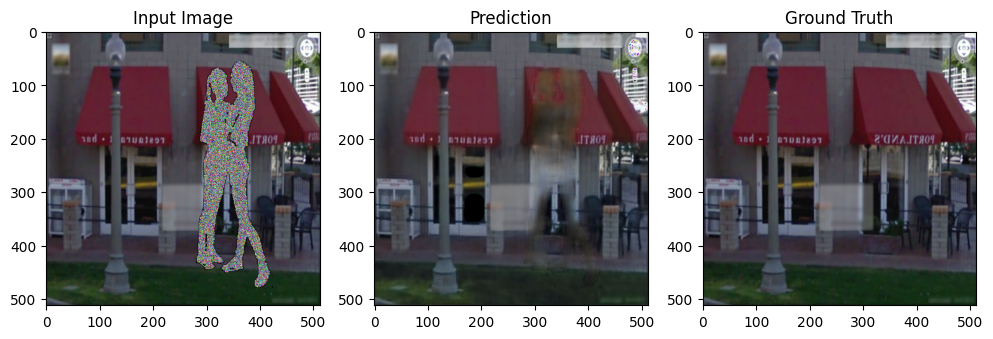

Epoch 31
=--------------------------------=
Train Loss: 0.007798246493829149, Validation Loss: 0.007056467169895768
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

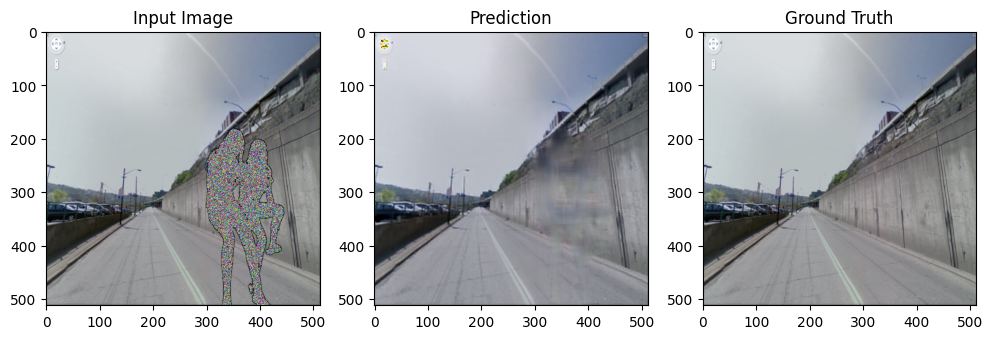

Epoch 32
=--------------------------------=
Train Loss: 0.00751002516065325, Validation Loss: 0.006917387768626213
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

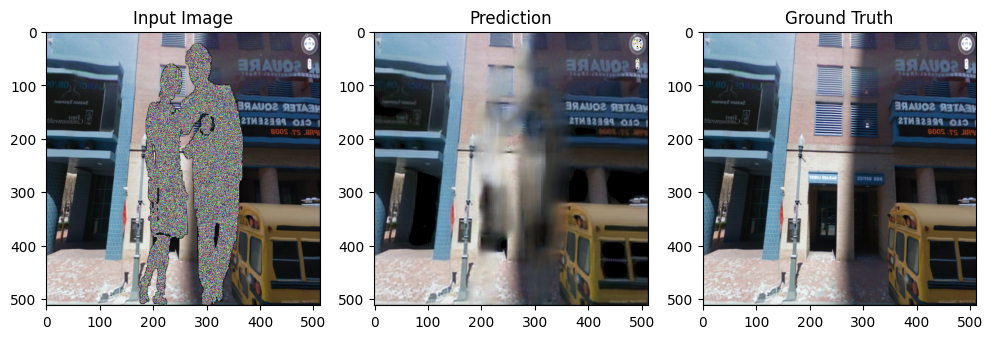

Epoch 33
=--------------------------------=
Train Loss: 0.007587174041795411, Validation Loss: 0.006814944292418659
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

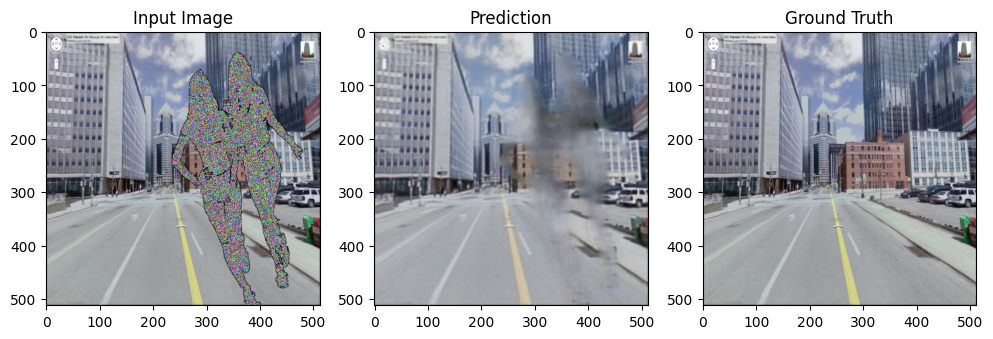

Epoch 34
=--------------------------------=
Train Loss: 0.009747029328718782, Validation Loss: 0.008659866000525653
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

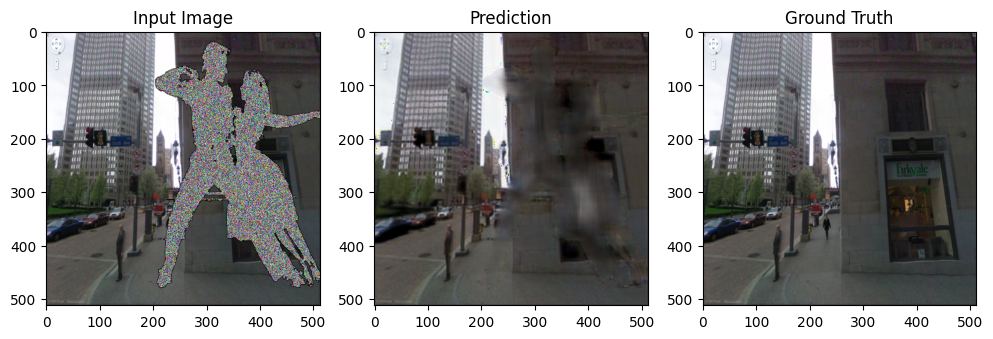

Epoch 35
=--------------------------------=
Train Loss: 0.009443658324224608, Validation Loss: 0.007628674986772239
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

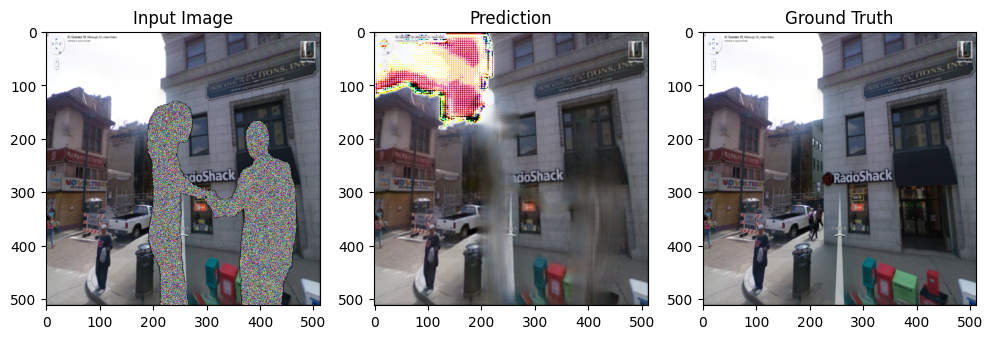

Epoch 36
=--------------------------------=
Train Loss: 0.008084911201149226, Validation Loss: 0.006947193485684693
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

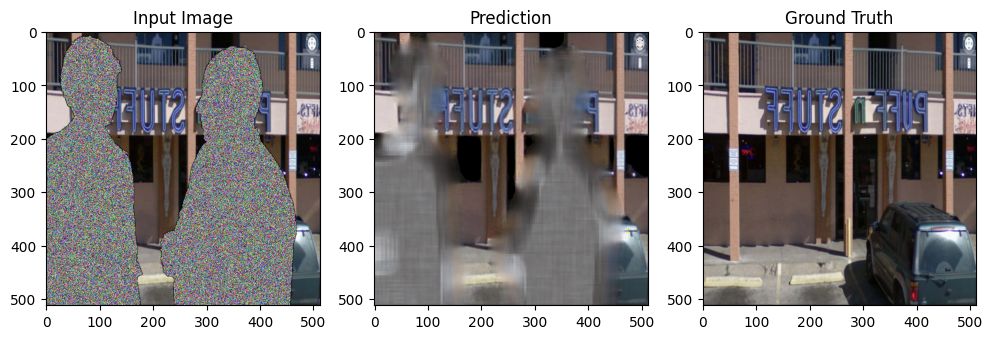

Epoch 37
=--------------------------------=
Train Loss: 0.007791108924097248, Validation Loss: 0.0070475947763770815
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

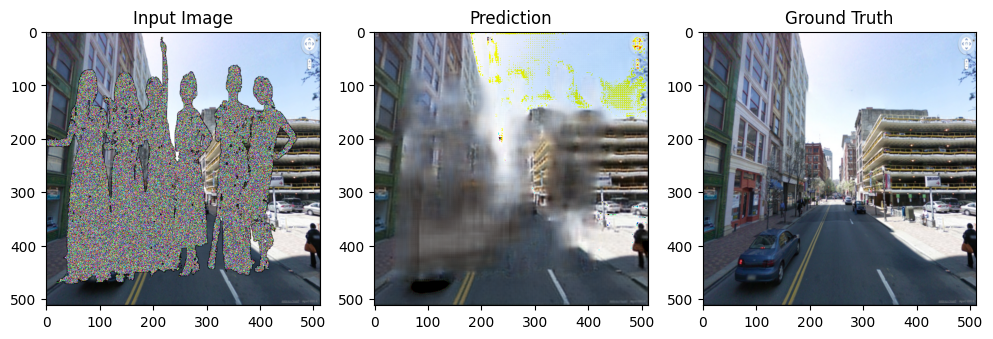

Epoch 38
=--------------------------------=
Train Loss: 0.0076476528076454995, Validation Loss: 0.006967867198400199
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

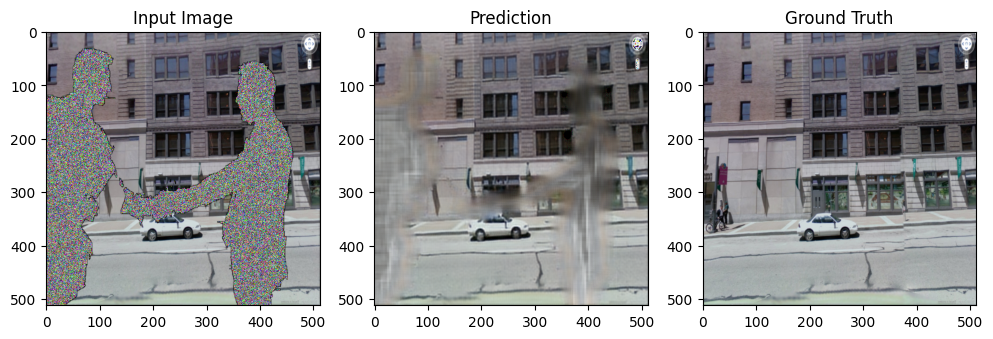

Epoch 39
=--------------------------------=
Train Loss: 0.007575761240773967, Validation Loss: 0.007280929847620427
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

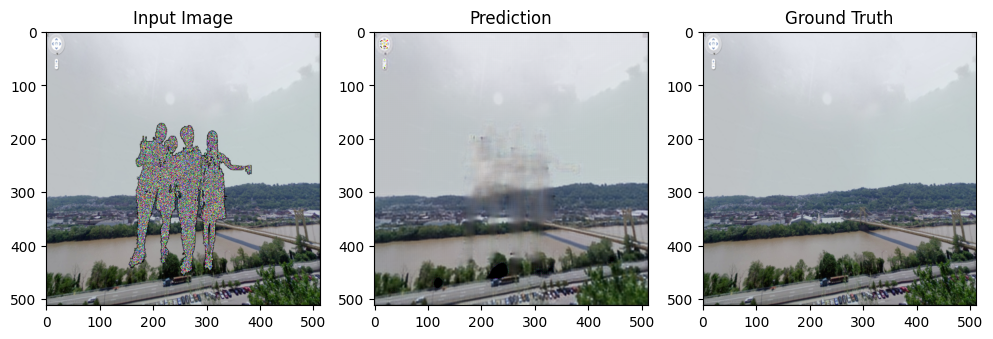

Epoch 40
=--------------------------------=
Train Loss: 0.007390075667561697, Validation Loss: 0.006832009325735271
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

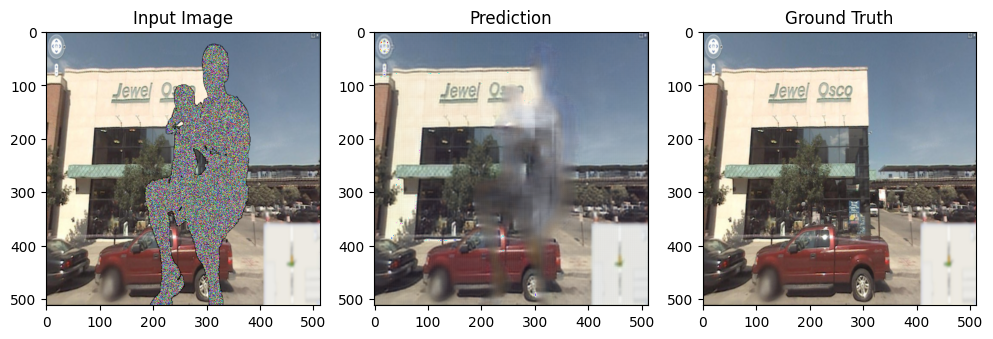

Epoch 41
=--------------------------------=
Train Loss: 0.007455333546801869, Validation Loss: 0.007140258951112628
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

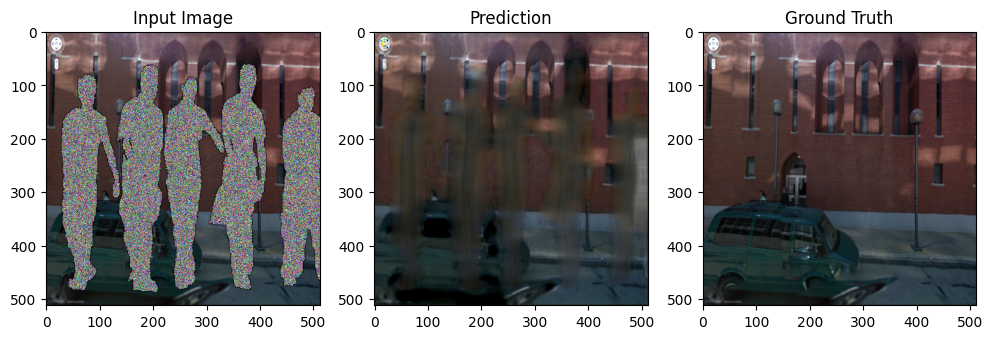

Epoch 42
=--------------------------------=
Train Loss: 0.00818932975442814, Validation Loss: 0.0072052300348877905
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

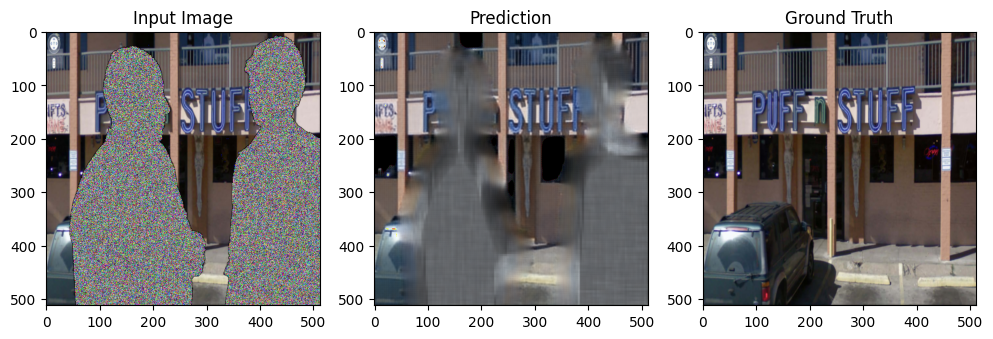

Epoch 43
=--------------------------------=
Train Loss: 0.007388408601816211, Validation Loss: 0.00700960023328662
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

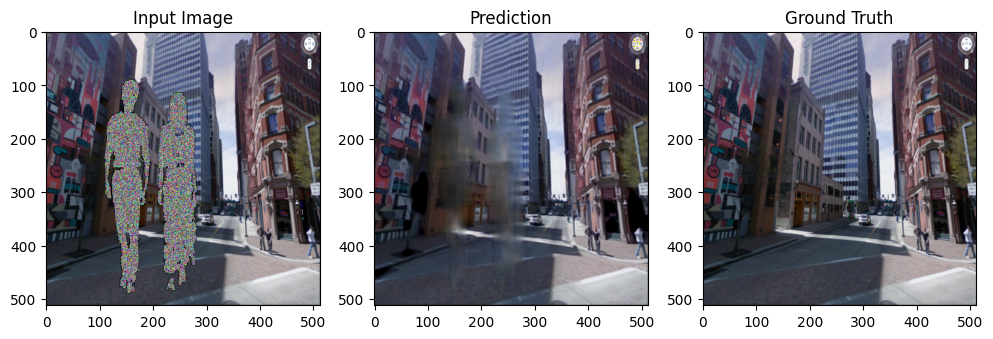

Epoch 44
=--------------------------------=
Train Loss: 0.007775601764608707, Validation Loss: 0.006850382853299379
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

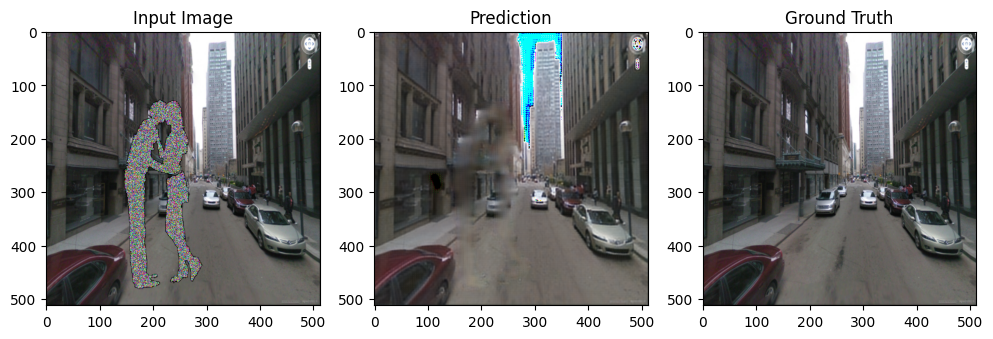

Epoch 45
=--------------------------------=
Train Loss: 0.0073717082983681135, Validation Loss: 0.007642154693603516
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

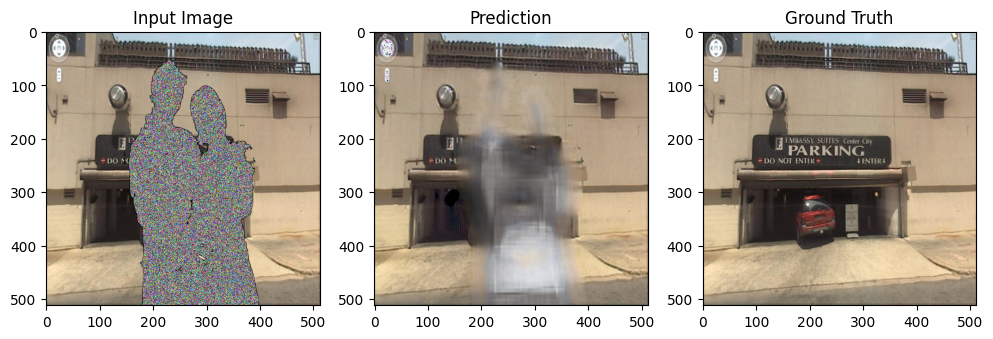

Epoch 46
=--------------------------------=
Train Loss: 0.007374319982981044, Validation Loss: 0.0069850204745307565
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

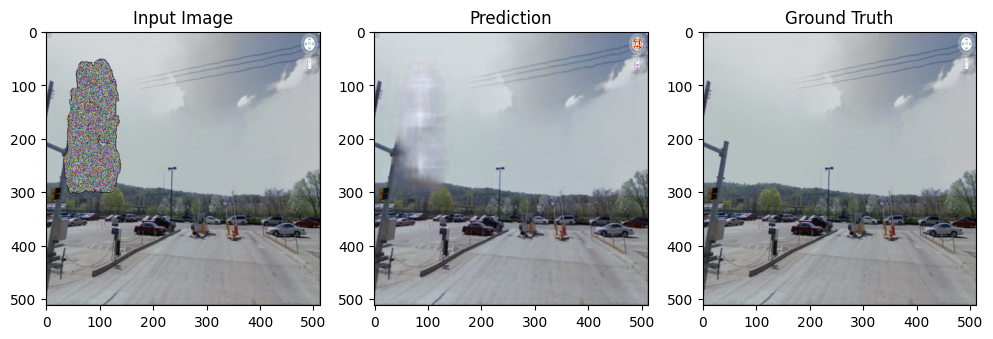

Epoch 47
=--------------------------------=
Train Loss: 0.007207963650580495, Validation Loss: 0.006824871150311083
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

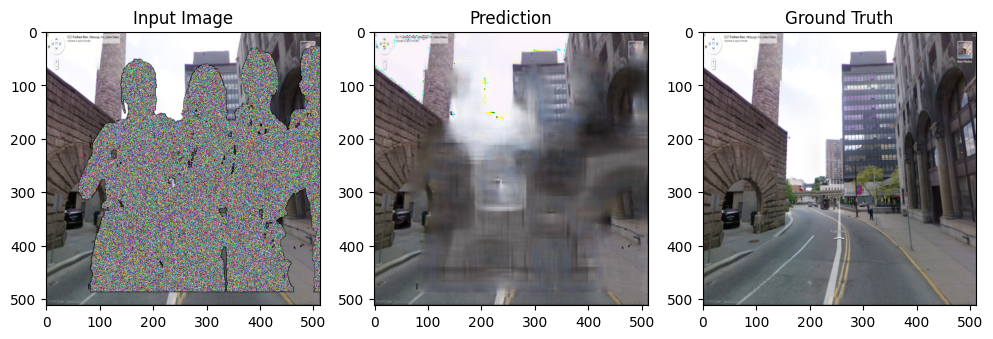

Epoch 48
=--------------------------------=
Train Loss: 0.007515542007916208, Validation Loss: 0.0067411958053708075
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

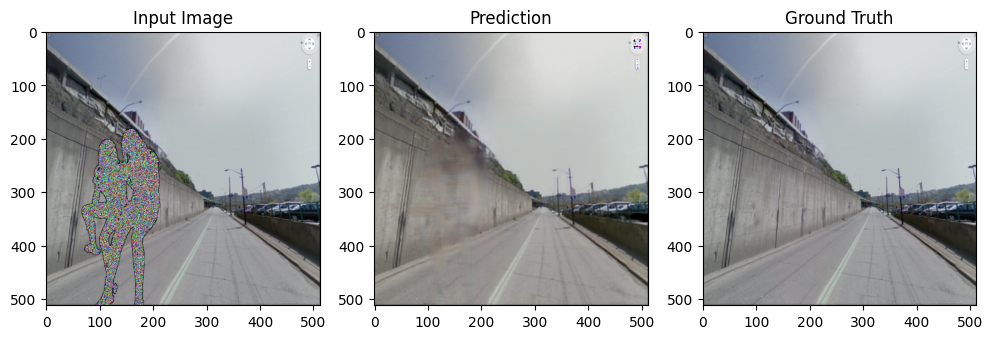

Epoch 49
=--------------------------------=
Train Loss: 0.007291335244995675, Validation Loss: 0.007357113929465413
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

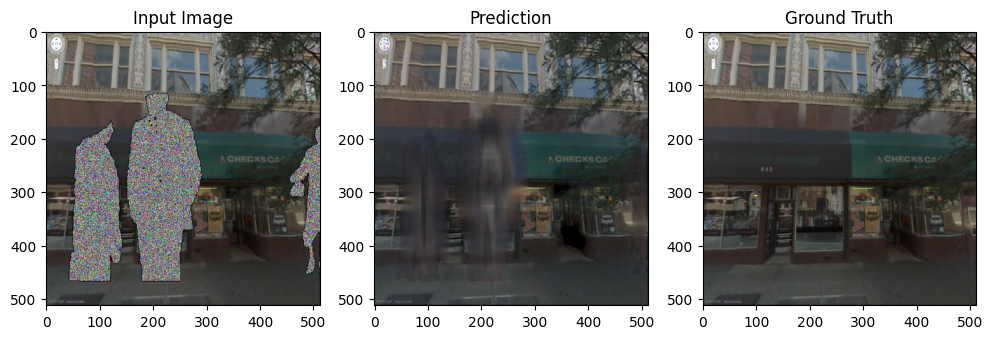

Epoch 50
=--------------------------------=
Train Loss: 0.007112116085564984, Validation Loss: 0.006889536865055561
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.006739631243981421 -> 0.006696245642378926


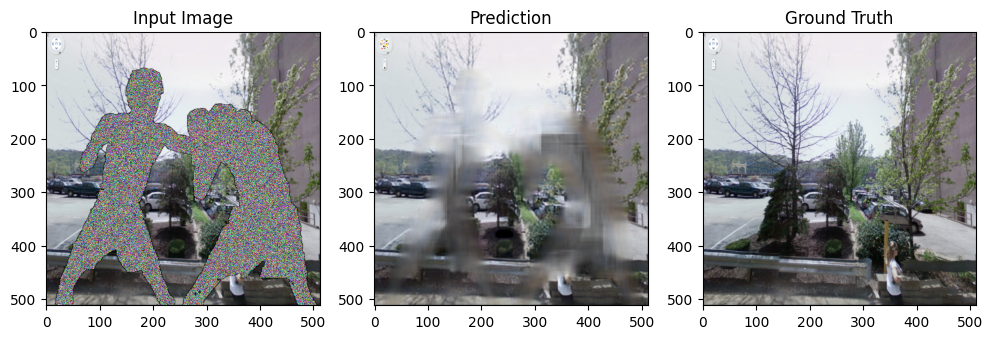

Epoch 51
=--------------------------------=
Train Loss: 0.007196241455052846, Validation Loss: 0.006696245642378926
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.006696245642378926 -> 0.00662374802865088


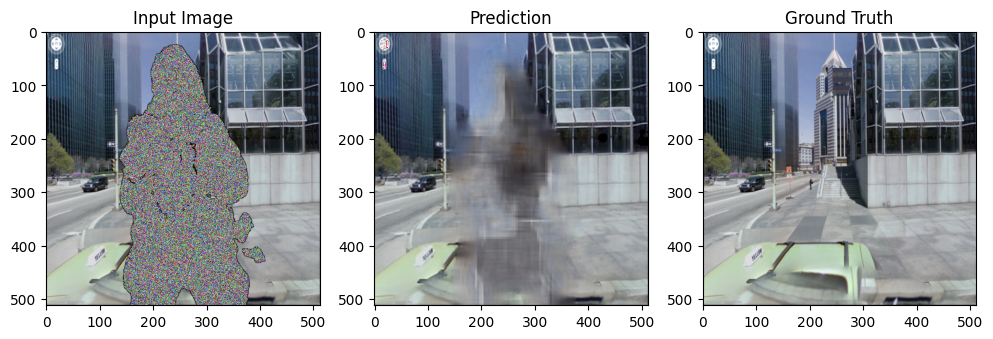

Epoch 52
=--------------------------------=
Train Loss: 0.007239183200623042, Validation Loss: 0.00662374802865088
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

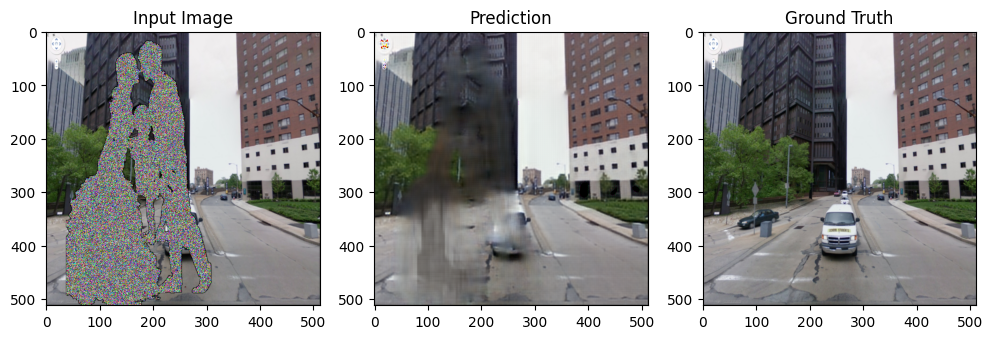

Epoch 53
=--------------------------------=
Train Loss: 0.007208915505491729, Validation Loss: 0.0066345369815826415
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.00662374802865088 -> 0.0065977204078808424


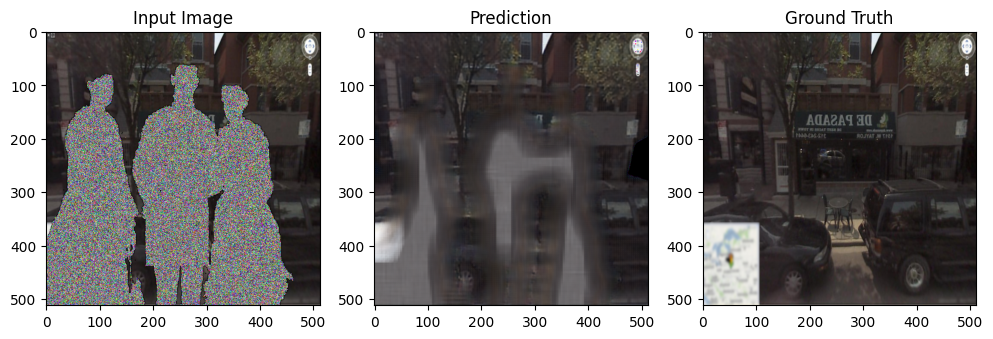

Epoch 54
=--------------------------------=
Train Loss: 0.0071633004433741525, Validation Loss: 0.0065977204078808424
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

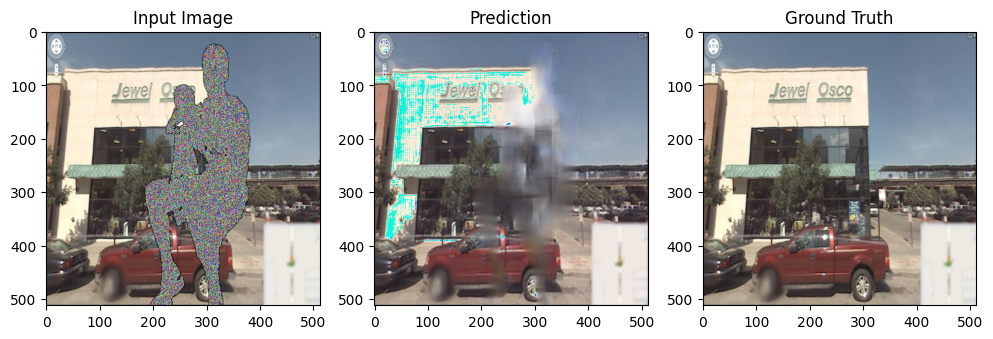

Epoch 55
=--------------------------------=
Train Loss: 0.0077536179002241365, Validation Loss: 0.006815318348817528
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

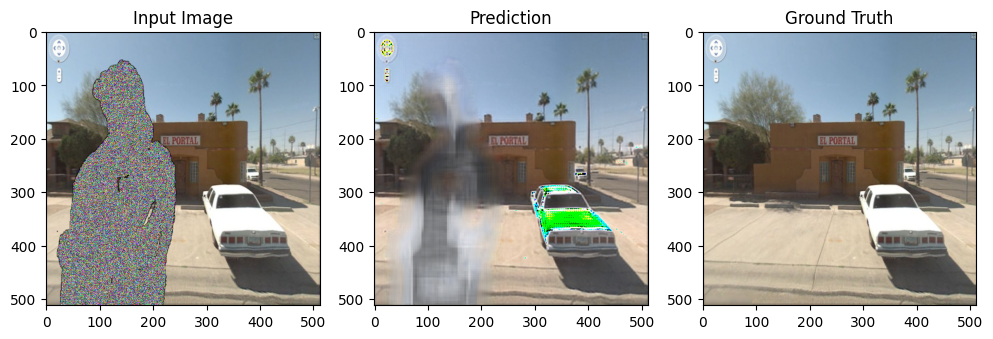

Epoch 56
=--------------------------------=
Train Loss: 0.007277996460574546, Validation Loss: 0.0073531959857791665
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

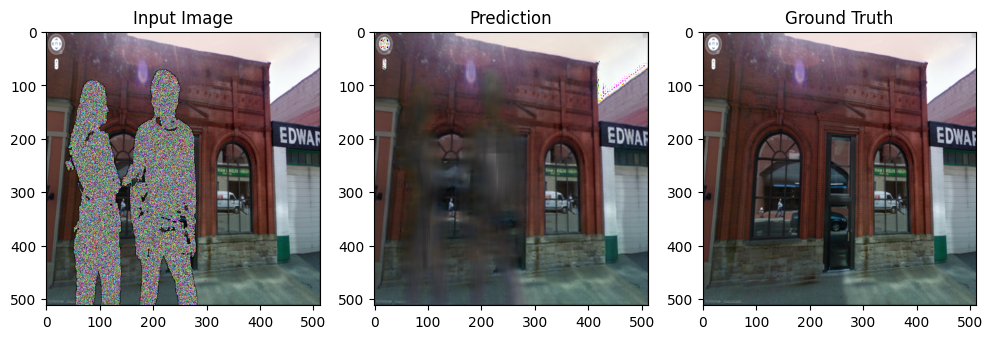

Epoch 57
=--------------------------------=
Train Loss: 0.007372228121052363, Validation Loss: 0.006707598851062357
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

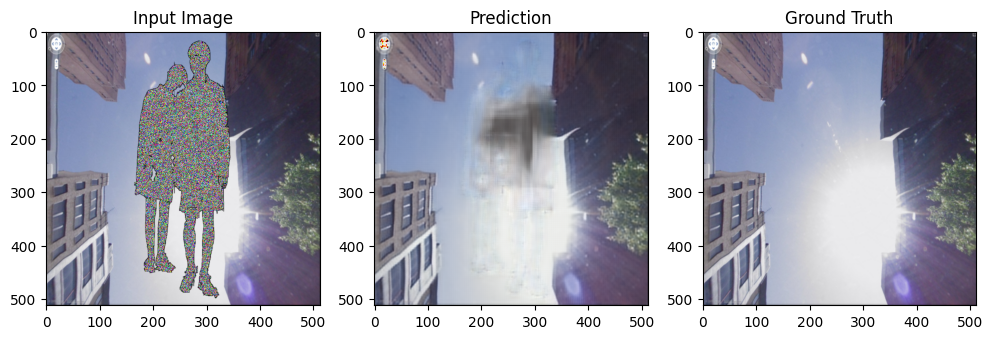

Epoch 58
=--------------------------------=
Train Loss: 0.0074519917784657864, Validation Loss: 0.007363442066125572
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

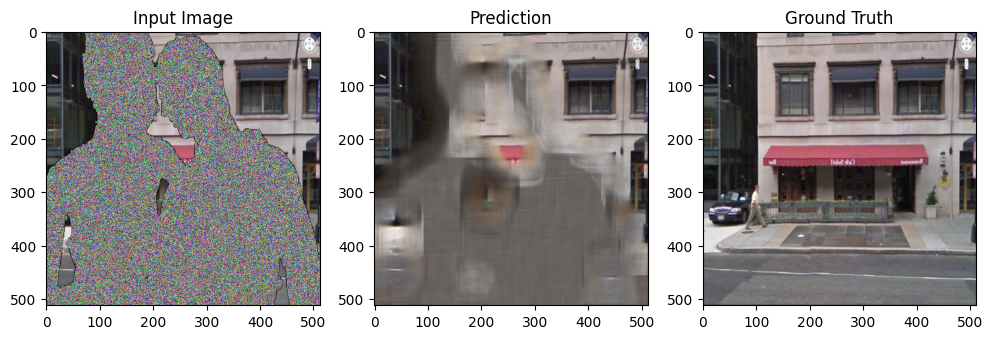

Epoch 59
=--------------------------------=
Train Loss: 0.00746353262802586, Validation Loss: 0.006761322999373078
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

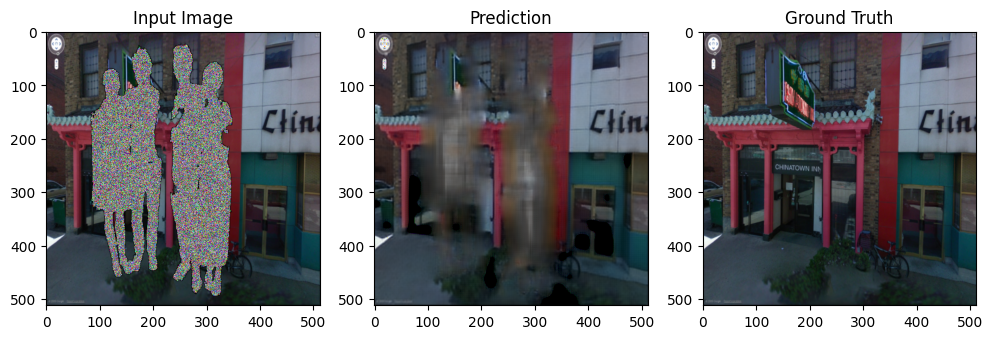

Epoch 60
=--------------------------------=
Train Loss: 0.007143025353018727, Validation Loss: 0.006870838701725006
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

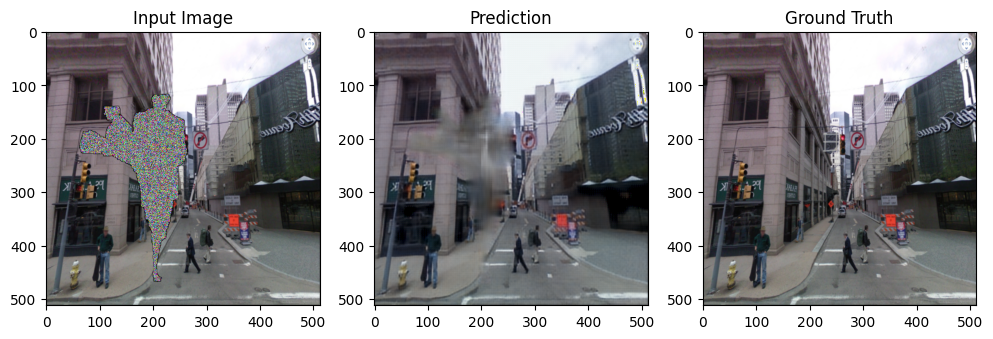

Epoch 61
=--------------------------------=
Train Loss: 0.0071942757382722836, Validation Loss: 0.007092179665341973
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

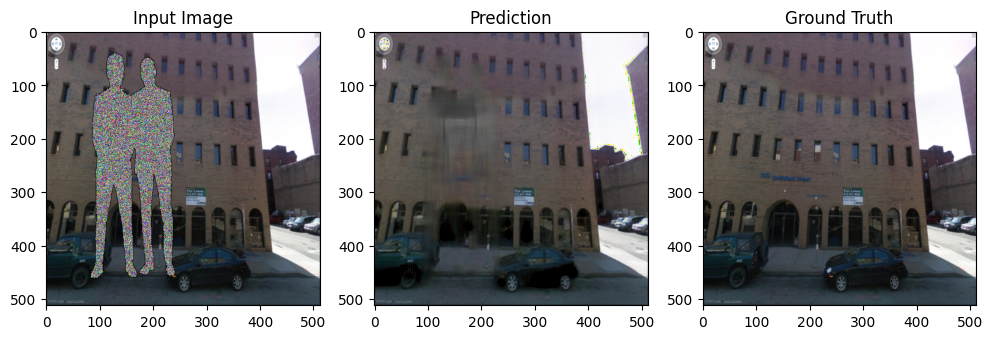

Epoch 62
=--------------------------------=
Train Loss: 0.006942497546385442, Validation Loss: 0.006601125840097666
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

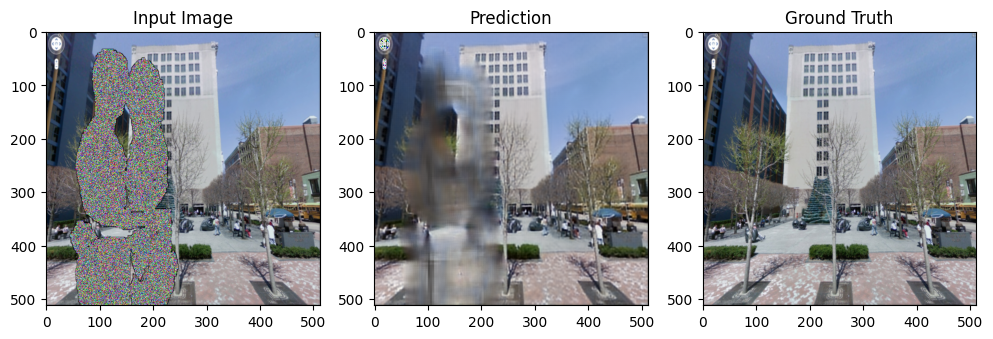

Epoch 63
=--------------------------------=
Train Loss: 0.007336463388388178, Validation Loss: 0.007390573318116367
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

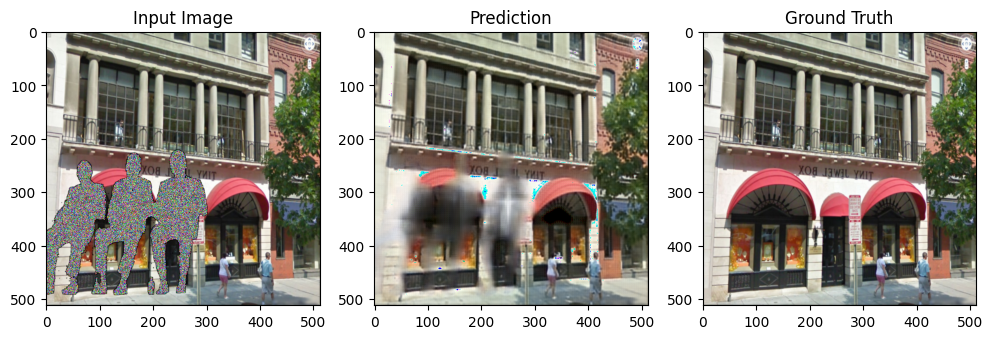

Epoch 64
=--------------------------------=
Train Loss: 0.007224157055108143, Validation Loss: 0.006758415373042226
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

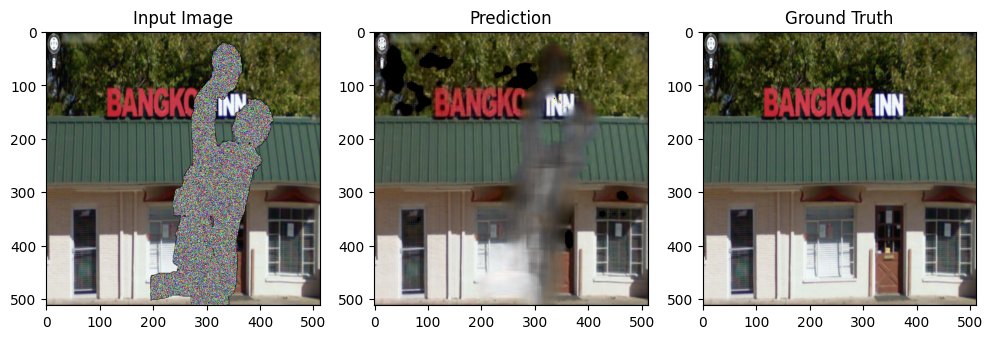

Epoch 65
=--------------------------------=
Train Loss: 0.007187785339608256, Validation Loss: 0.006806235695257783
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

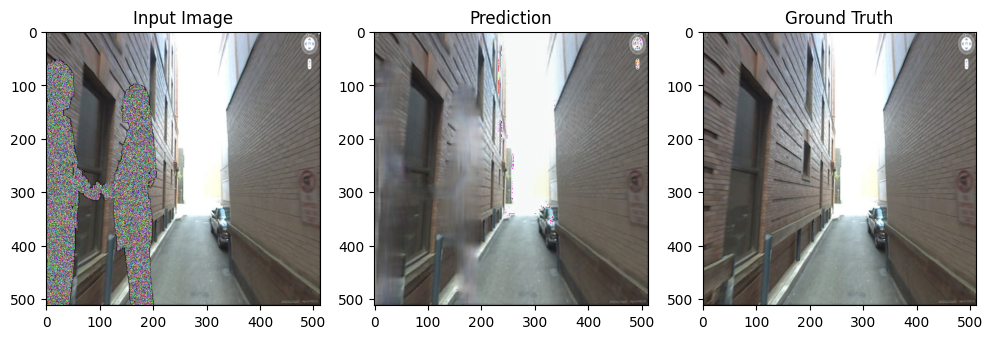

Epoch 66
=--------------------------------=
Train Loss: 0.007107383361186034, Validation Loss: 0.006886446084827184
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

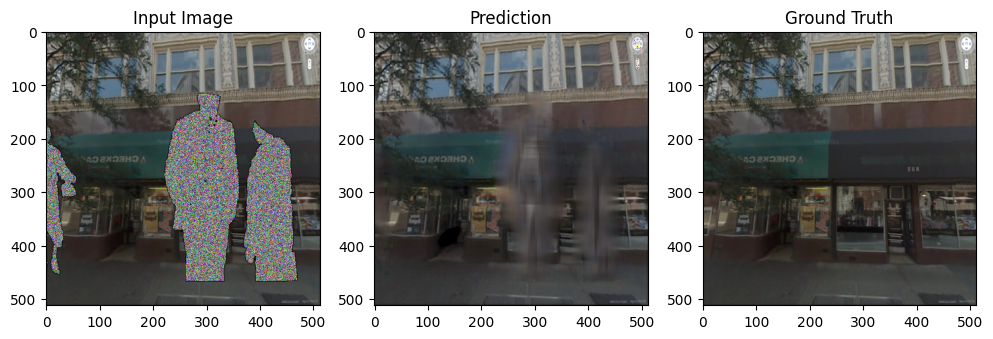

Epoch 67
=--------------------------------=
Train Loss: 0.007169003383855202, Validation Loss: 0.0067882609507068994
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

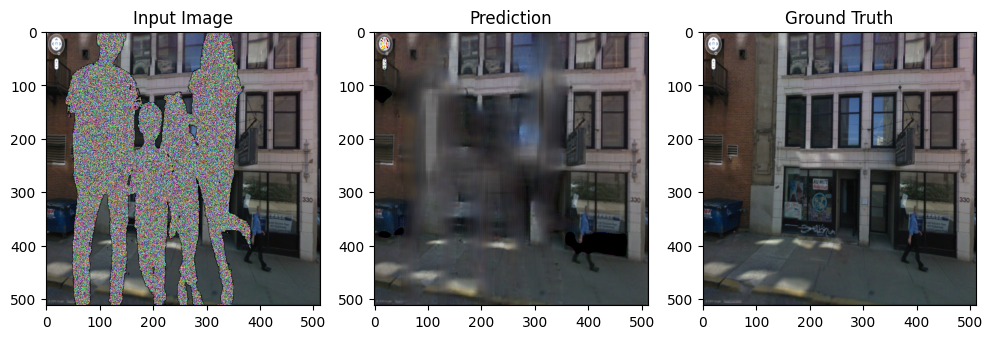

Epoch 68
=--------------------------------=
Train Loss: 0.007214510397586439, Validation Loss: 0.0066186641366221015
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

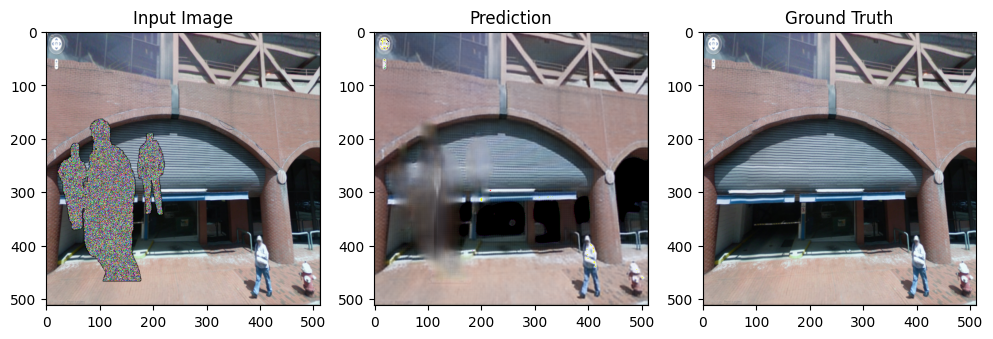

Epoch 69
=--------------------------------=
Train Loss: 0.006996127286194158, Validation Loss: 0.006694336878135801
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

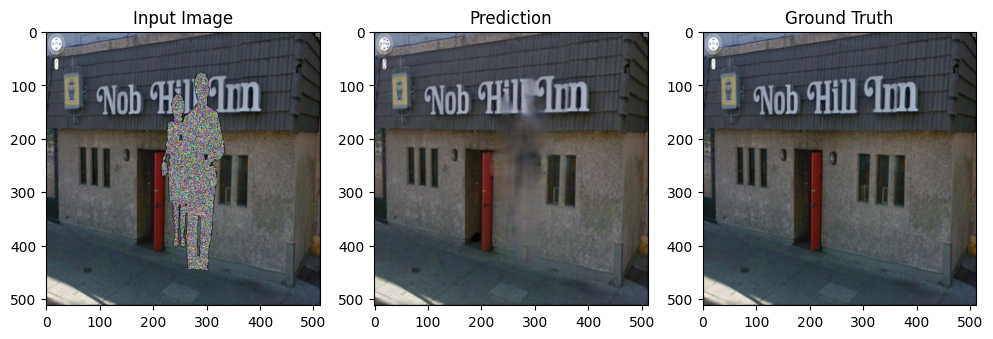

Epoch 70
=--------------------------------=
Train Loss: 0.007059650613726782, Validation Loss: 0.006733305267989636
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

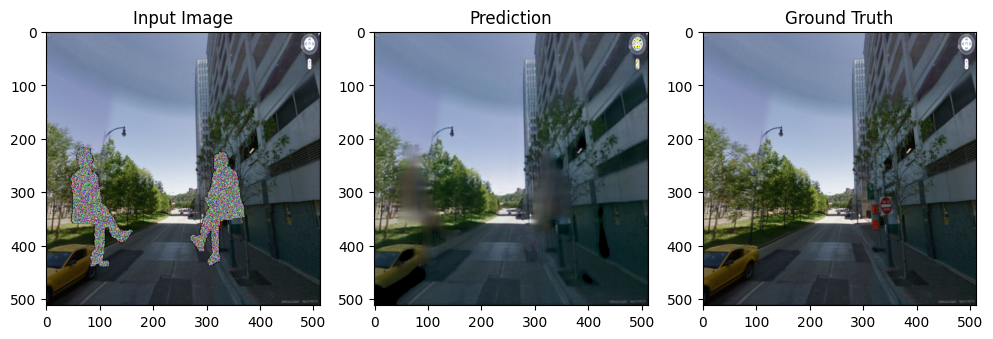

Epoch 71
=--------------------------------=
Train Loss: 0.007146764157472976, Validation Loss: 0.00693478476954624
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

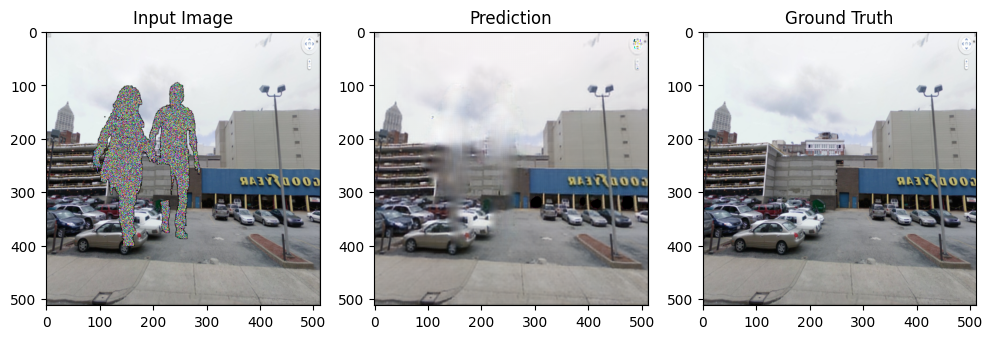

Epoch 72
=--------------------------------=
Train Loss: 0.007344946604488151, Validation Loss: 0.007144424021244049
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

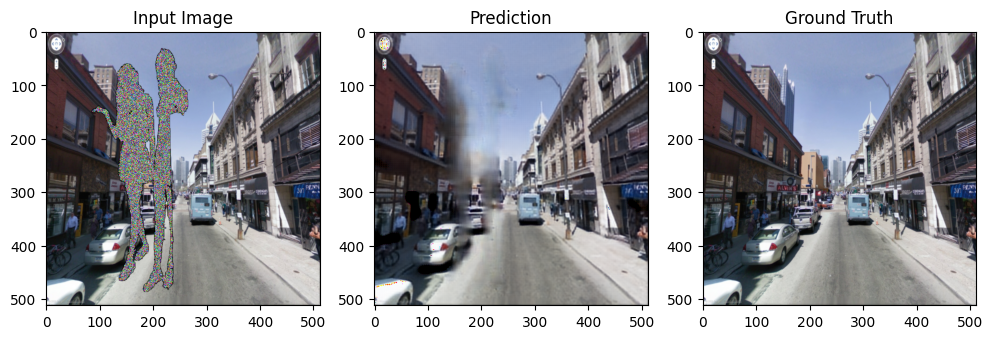

Epoch 73
=--------------------------------=
Train Loss: 0.007008516010163086, Validation Loss: 0.006604128945618868
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

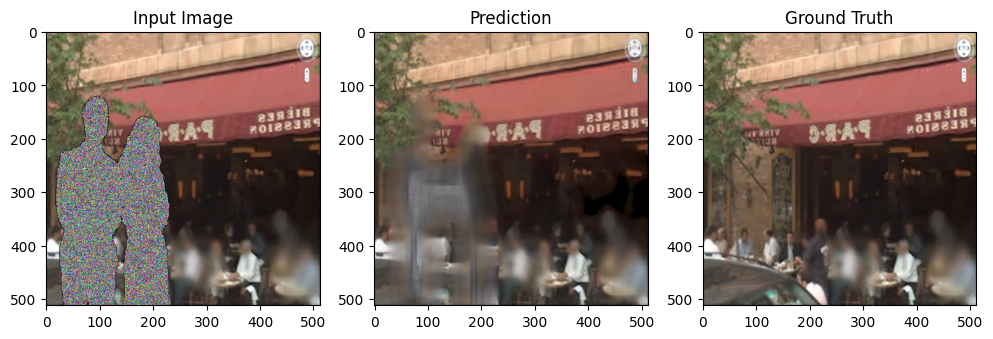

Epoch 74
=--------------------------------=
Train Loss: 0.007001225262813803, Validation Loss: 0.006843627355992794
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

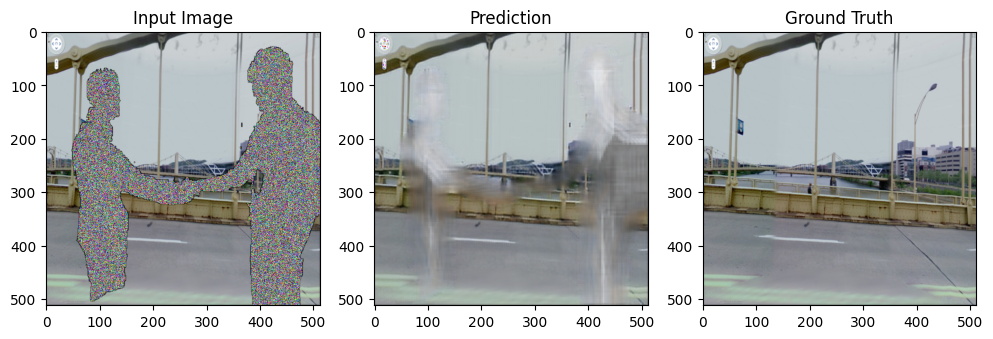

Epoch 75
=--------------------------------=
Train Loss: 0.007176687504397705, Validation Loss: 0.0068499271897599105
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.0065977204078808424 -> 0.0065721397614106536


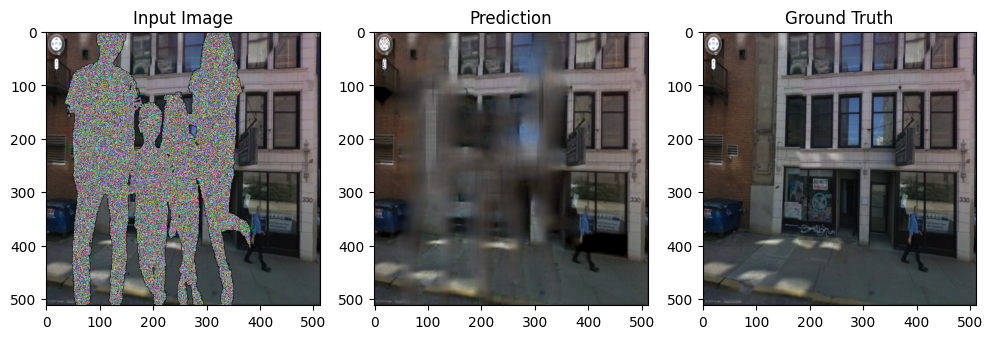

Epoch 76
=--------------------------------=
Train Loss: 0.006985663640911558, Validation Loss: 0.0065721397614106536
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

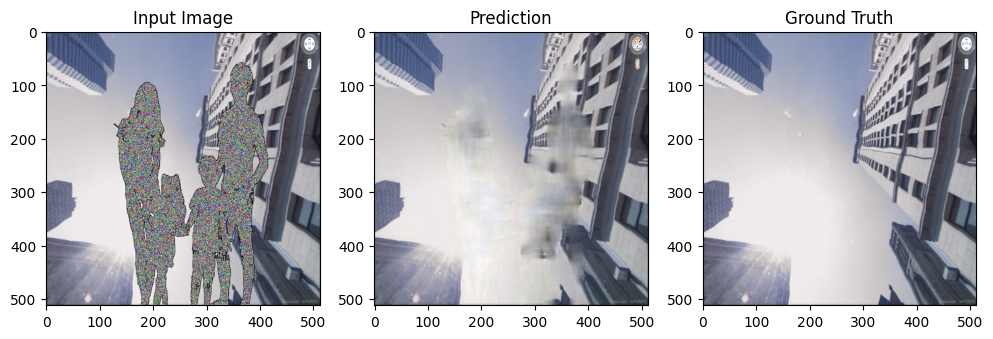

Epoch 77
=--------------------------------=
Train Loss: 0.0070635100693574975, Validation Loss: 0.0066498233983293175
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

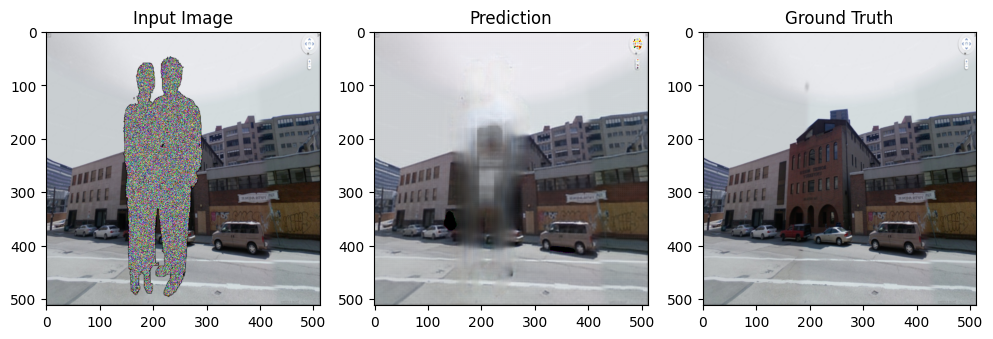

Epoch 78
=--------------------------------=
Train Loss: 0.006995954488437357, Validation Loss: 0.008697117087431252
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

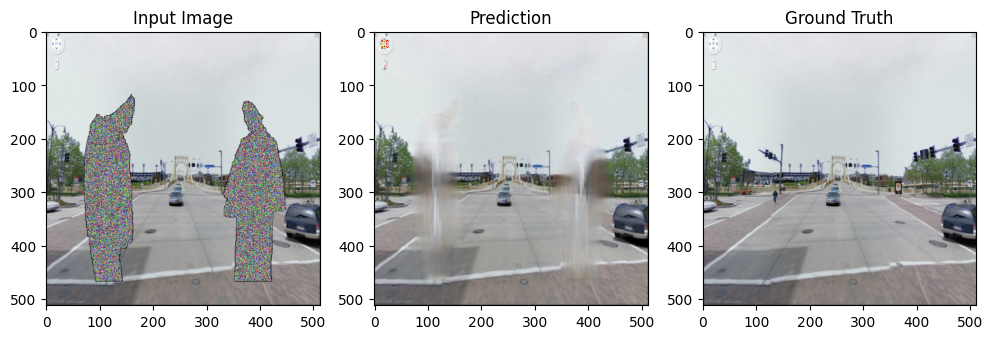

Epoch 79
=--------------------------------=
Train Loss: 0.006954477787283915, Validation Loss: 0.00685024042148143
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

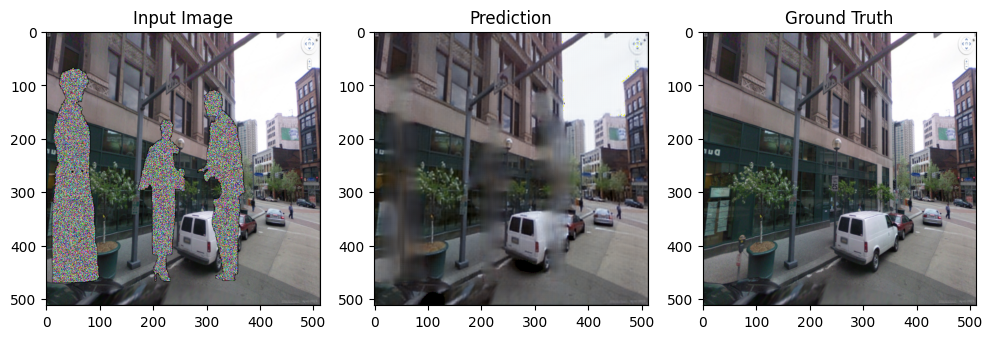

Epoch 80
=--------------------------------=
Train Loss: 0.007055838060166154, Validation Loss: 0.007086845273151994
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

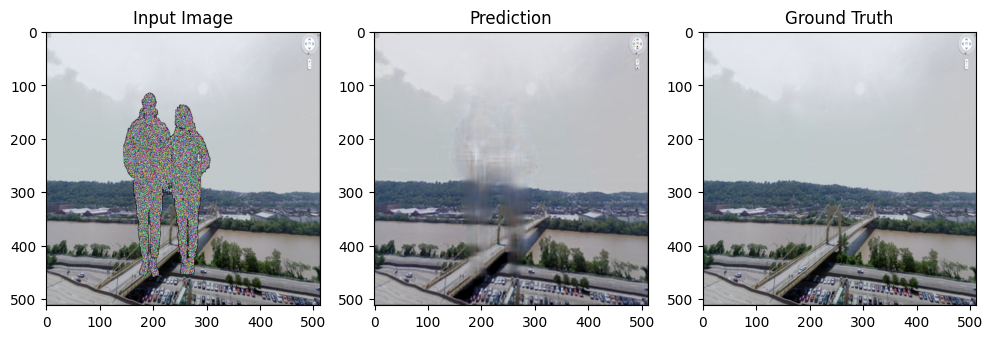

Epoch 81
=--------------------------------=
Train Loss: 0.006951436397087361, Validation Loss: 0.006623488978948444
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

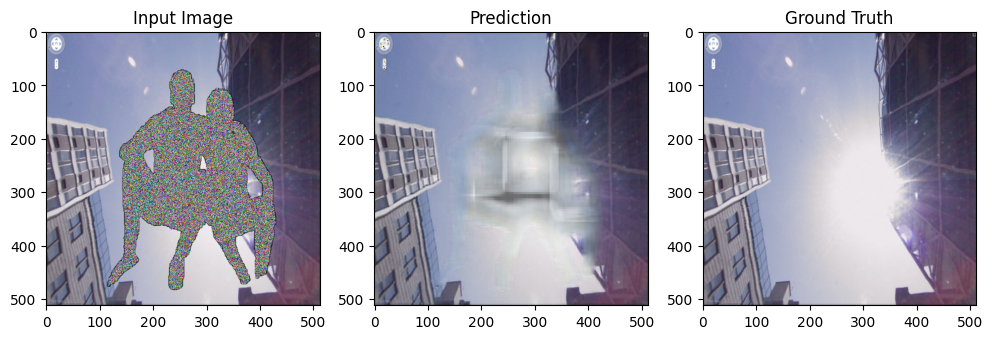

Epoch 82
=--------------------------------=
Train Loss: 0.007052020664559677, Validation Loss: 0.006892849600408226
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

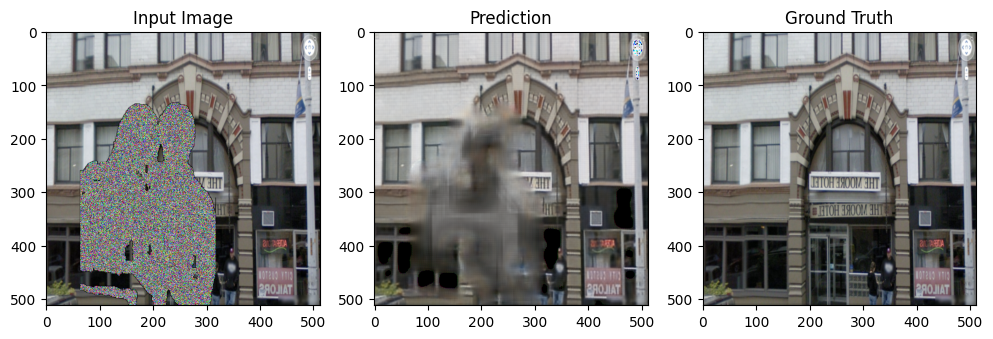

Epoch 83
=--------------------------------=
Train Loss: 0.006876485250956778, Validation Loss: 0.00781208660453558
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

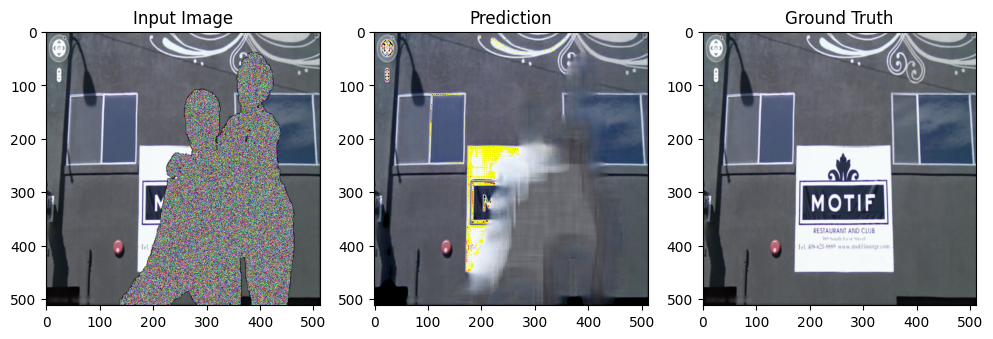

Epoch 84
=--------------------------------=
Train Loss: 0.007122348345416997, Validation Loss: 0.0067931371042504905
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

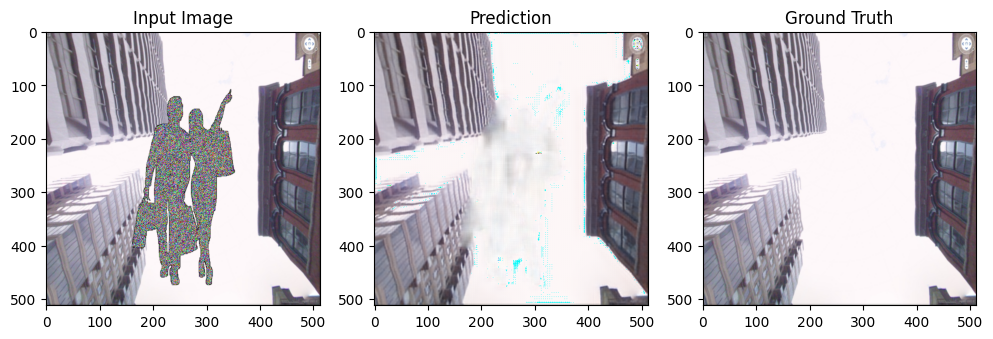

Epoch 85
=--------------------------------=
Train Loss: 0.007041516628981169, Validation Loss: 0.006651195487938822
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

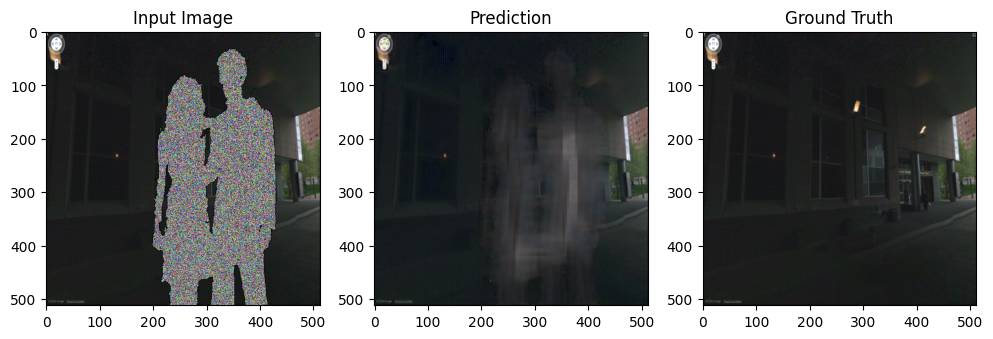

Epoch 86
=--------------------------------=
Train Loss: 0.007120278216565826, Validation Loss: 0.006720011131837964
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

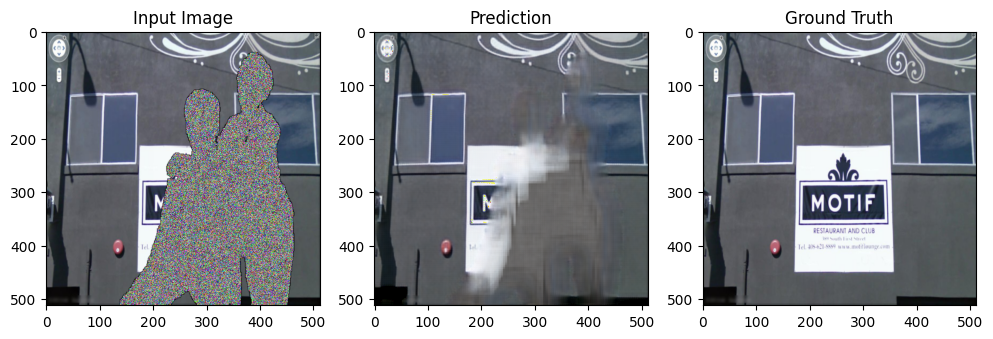

Epoch 87
=--------------------------------=
Train Loss: 0.00706920010603166, Validation Loss: 0.006695352690294385
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.0065721397614106536 -> 0.006496431692503393


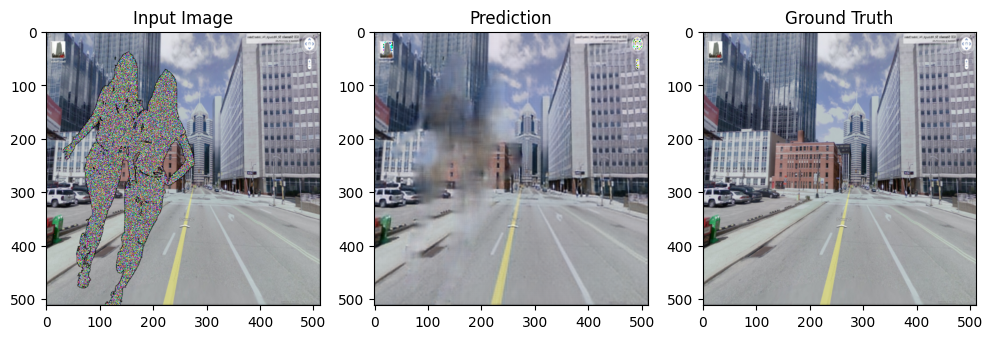

Epoch 88
=--------------------------------=
Train Loss: 0.006829280755482614, Validation Loss: 0.006496431692503393
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

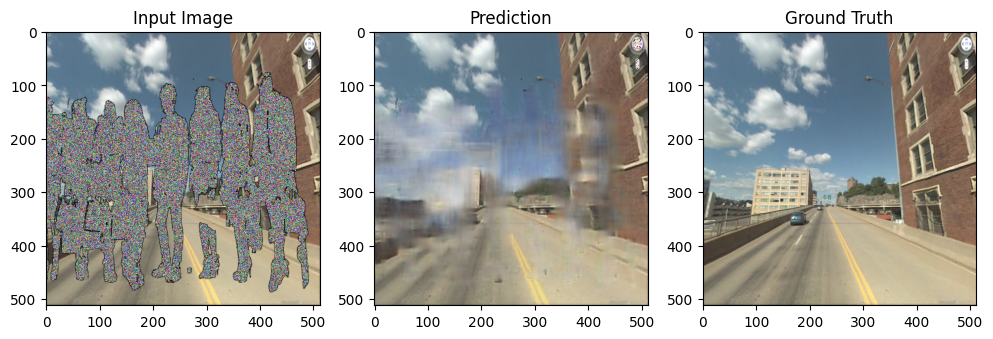

Epoch 89
=--------------------------------=
Train Loss: 0.006817752416411947, Validation Loss: 0.00657446137163788
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.006496431692503393 -> 0.006412813081406057


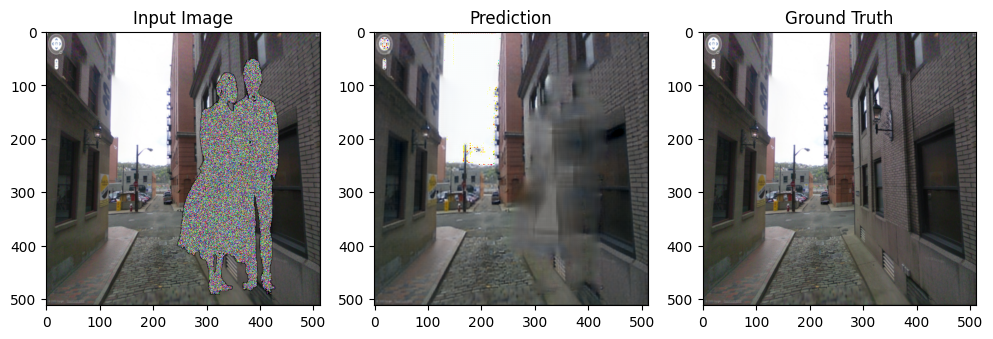

Epoch 90
=--------------------------------=
Train Loss: 0.006694145400043843, Validation Loss: 0.006412813081406057
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

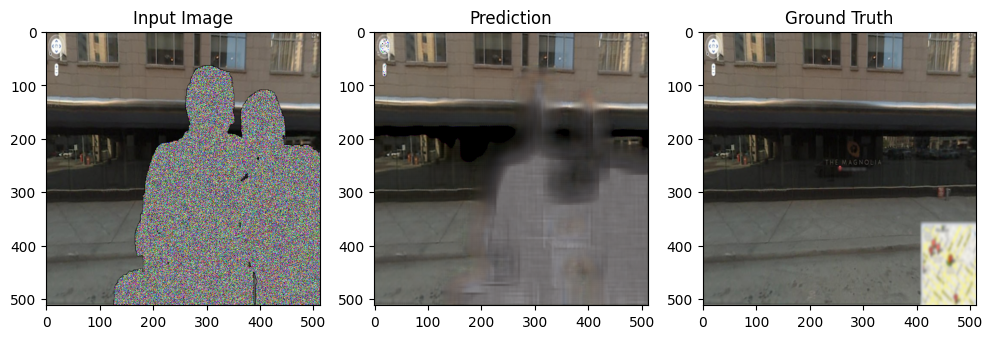

Epoch 91
=--------------------------------=
Train Loss: 0.006785477295384875, Validation Loss: 0.006529774884693324
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

Lowest Validation Loss ReNewed! 0.006412813081406057 -> 0.006398236237000674


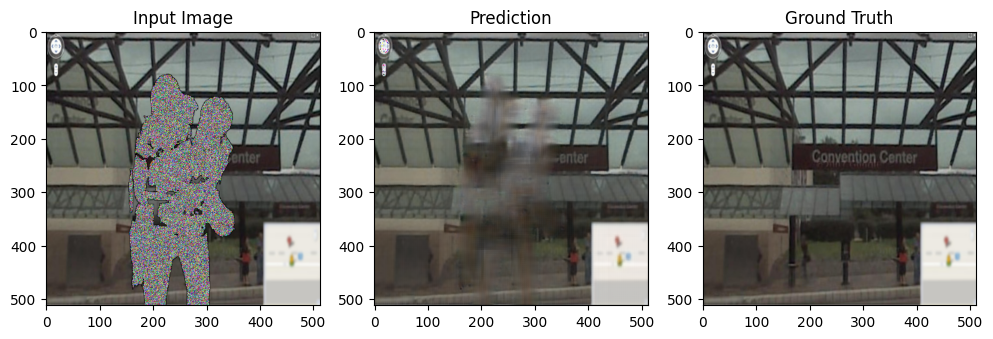

Epoch 92
=--------------------------------=
Train Loss: 0.006798092222639492, Validation Loss: 0.006398236237000674
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

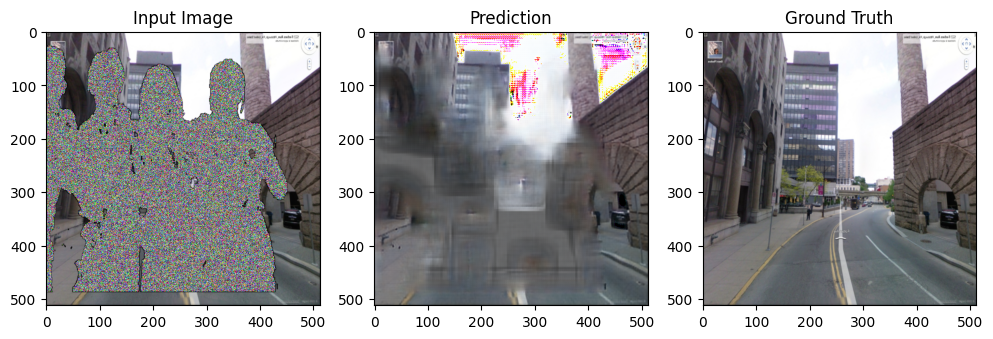

Epoch 93
=--------------------------------=
Train Loss: 0.006983608674324517, Validation Loss: 0.006562853618524969
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

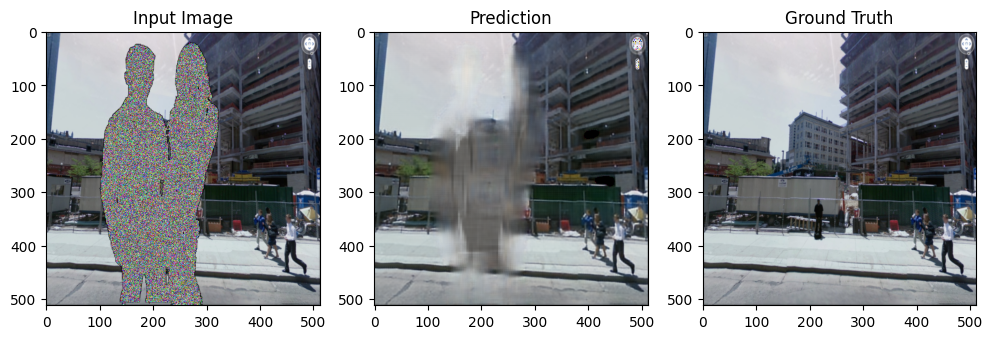

Epoch 94
=--------------------------------=
Train Loss: 0.006845937358281974, Validation Loss: 0.006660151206888259
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

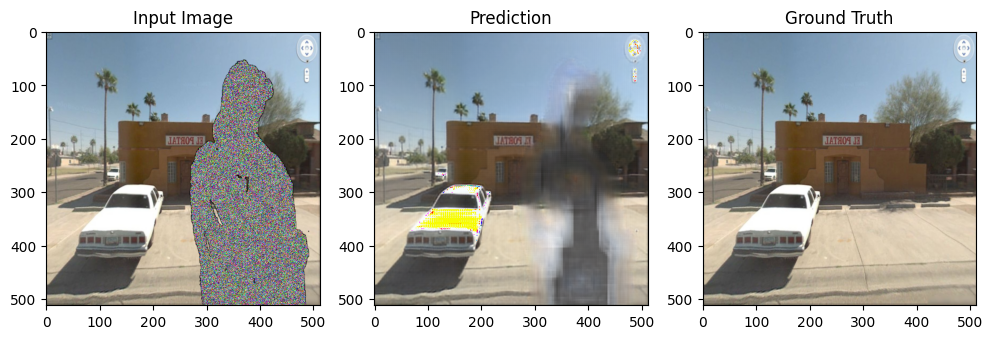

Epoch 95
=--------------------------------=
Train Loss: 0.007067737894664918, Validation Loss: 0.006787359514273703
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

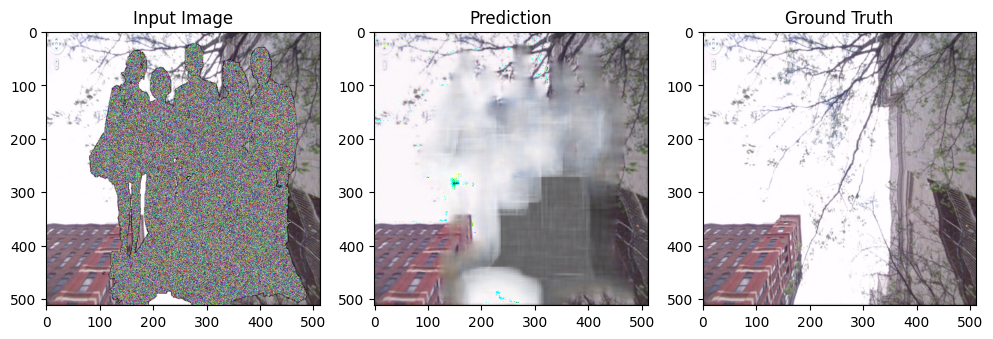

Epoch 96
=--------------------------------=
Train Loss: 0.006886602594750002, Validation Loss: 0.006467431667260826
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

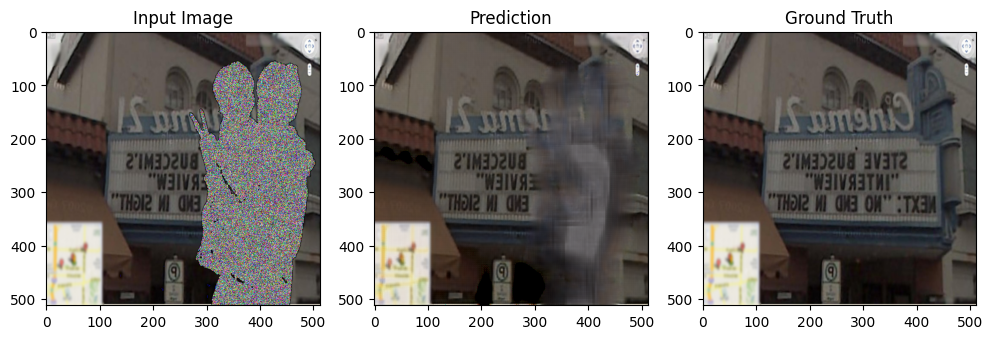

Epoch 97
=--------------------------------=
Train Loss: 0.006665540895690876, Validation Loss: 0.007061632135882973
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

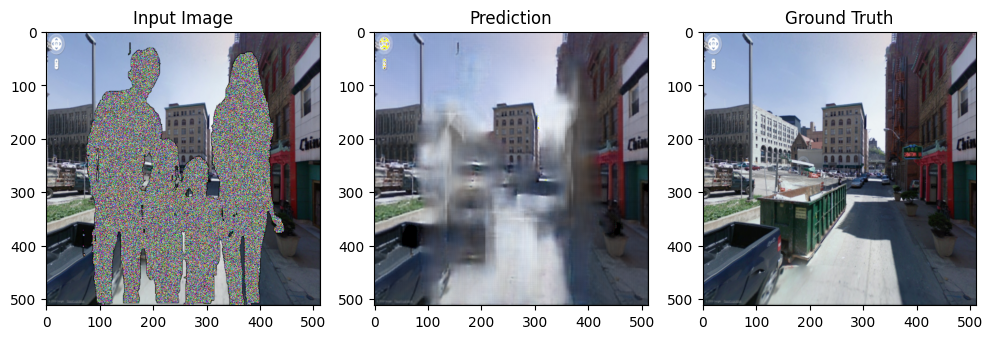

Epoch 98
=--------------------------------=
Train Loss: 0.006867716157077147, Validation Loss: 0.006752500233706087
=--------------------------------=


Training...:   0%|          | 0/140 [00:00<?, ?it/s]

Validating...:   0%|          | 0/50 [00:00<?, ?it/s]

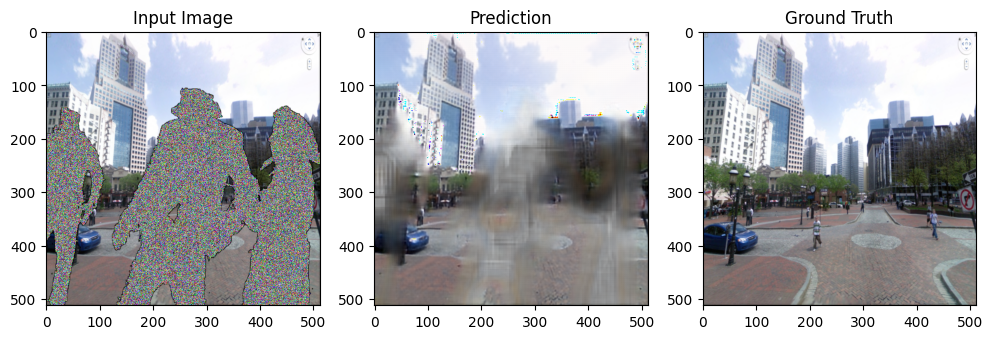

Epoch 99
=--------------------------------=
Train Loss: 0.006779518136422017, Validation Loss: 0.0071524701616726815
=--------------------------------=


In [17]:
best_score = np.inf
train_loss, valid_loss = list(), list()
for epoch in range(EPOCH):
    model.train()
    running_loss = 0
    for masked_background, background in tqdm(train_loader, desc = 'Training...'):
        masked_background = masked_background.to(device)
        background = background.to(device)
        
        output = model(masked_background)
        
        loss = criterion(output, background)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    train_loss.append(running_loss / len(train_loader))
    
    model.eval()
    running_loss = 0
    with torch.no_grad():
        for masked_background, background in tqdm(valid_loader, desc = 'Validating...'):
            masked_background = masked_background.to(device)
            background = background.to(device)
            
            output = model(masked_background)
            
            loss = criterion(output, background)
            running_loss += loss.item()
        valid_loss.append(running_loss / len(valid_loader))
        if best_score > valid_loss[-1]:
            print(f'Lowest Validation Loss ReNewed! {best_score} -> {valid_loss[-1]}')
            best_score = valid_loss[-1]
            torch.save(model.state_dict(), f'./models/FCAE/Epoch_{epoch}_best_model.pth')
        
        # print(f'Masked Background Shape: {masked_background.shape}\nOutput Shape: {background.shape}\nGround Truth Shape: {background.shape}')
        
        # plt.imshow((output[0, 0, :, :].cpu().detach().numpy() * 255).astype(np.uint8))
        # plt.show()
        
        mb_to_show = masked_background.cpu().detach().permute(0, 2, 3, 1).numpy()
        op_to_show = output.cpu().detach().permute(0, 2, 3, 1).numpy()
        bg_to_show = background.cpu().detach().permute(0, 2, 3, 1).numpy()
        
        plt.figure(figsize = (12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow((mb_to_show[0] * 255).astype(np.uint8))
        plt.title('Input Image')
        plt.subplot(1, 3, 2)
        plt.imshow((op_to_show[0] * 255).astype(np.uint8))
        plt.title('Prediction')
        plt.subplot(1, 3, 3)
        plt.imshow((bg_to_show[0] * 255).astype(np.uint8))
        plt.title('Ground Truth')
        plt.show()
        
    print(f'Epoch {epoch}\n=--------------------------------=\nTrain Loss: {train_loss[-1]}, Validation Loss: {valid_loss[-1]}\n=--------------------------------=')

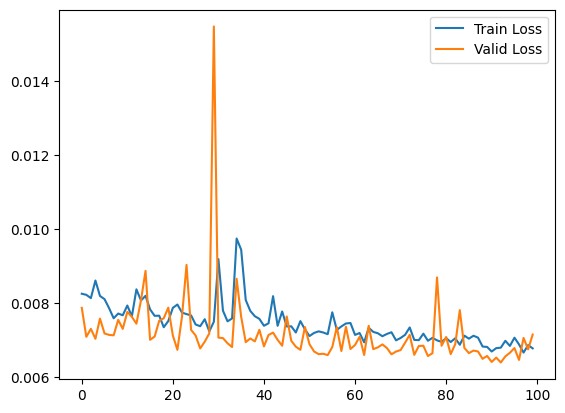

In [18]:
plt.plot(train_loss)
plt.plot(valid_loss)
plt.legend(['Train Loss', 'Valid Loss'])
plt.show()